<a href="https://colab.research.google.com/github/sijuswamyresearch/AFS-Survey/blob/main/AF_Survey_Paper_Basic_Tasks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Activation function Plots

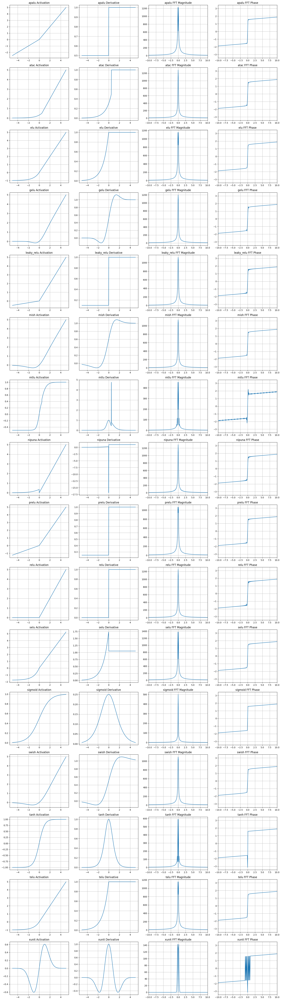

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftshift

class ActivationLibrary:
    """All AFs used in image restoration (basic to cutting-edge)"""
    @staticmethod
    def sigmoid(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def tanh(x):
        return np.tanh(x)

    @staticmethod
    def relu(x):
        return np.maximum(0, x)

    @staticmethod
    def leaky_relu(x, alpha=0.1):
        return np.where(x > 0, x, alpha * x)

    @staticmethod
    def prelu(x, alpha=0.25):
        return np.where(x > 0, x, alpha * x)

    @staticmethod
    def gelu(x):
        return 0.5 * x * (1 + np.tanh(np.sqrt(2/np.pi) * (x + 0.044715 * x**3)))

    @staticmethod
    def elu(x, alpha=1.0):
        return np.where(x > 0, x, alpha * (np.exp(x) - 1))

    @staticmethod
    def selu(x):
        scale = 1.0507
        alpha = 1.67326
        return scale * np.where(x > 0, x, alpha * (np.exp(x) - 1))

    @staticmethod
    def swish(x):
        return x / (1 + np.exp(-x))

    @staticmethod
    def mish(x):
        return x * np.tanh(np.log(1 + np.exp(x)))

    @staticmethod
    def xunit(x):
        """XUnit: S-shaped with learned threshold"""
        return x * np.exp(-(x**2)/2)

    @staticmethod
    def mtlu(x, threshold=0.5):
        """MTLU: Modified Tanh Unit"""
        return np.where(x > threshold, np.tanh(x), 0.5*np.tanh(2*x))

    @staticmethod
    def nipuna(x, alpha=0.5):
        """NIPUNA: Non-Increasing Piecewise Unit with Negative Adaptation"""
        return np.where(x > 0, x, alpha * np.log(1 + np.exp(x)))

    @staticmethod
    def telu(x, lambda_=1.0):
        """TeLU: Thresholded Exponential Linear Unit"""
        return np.where(x > 0, x, lambda_ * (np.exp(x) - 1))

    @staticmethod
    def atac(x, tau=0.5):
        """ATAC: Adaptive Threshold Activation"""
        return np.where(x > tau, x, tau * np.exp(x - tau))

    @staticmethod
    def apalu(x, alpha=0.5, beta=1.0):
        """APALU: Adaptive Piecewise Approximated Linear Unit"""
        return np.where(x > 0, beta * x, alpha * x)

# Create a grid of plots
activation_names = [name for name in dir(ActivationLibrary) if not name.startswith('__')]
num_activations = len(activation_names)

# Common input domain
x = np.linspace(-5, 5, 1000)
dx = x[1] - x[0]  # For FFT frequency calculation

# Set up the figure
plt.figure(figsize=(18, 4*num_activations))

for i, name in enumerate(activation_names):
    # Get the activation function
    func = getattr(ActivationLibrary, name)

    # Compute activation and its numerical derivative
    y = func(x)
    dy = np.gradient(y, x)

    # Compute FFT
    fft_values = fftshift(fft(y))
    freqs = fftshift(np.fft.fftfreq(len(x), dx))

    # Create subplots for each activation function
    plt.subplot(num_activations, 4, 4*i + 1)
    plt.plot(x, y)
    plt.title(f'{name} Activation')
    plt.grid(True)

    plt.subplot(num_activations, 4, 4*i + 2)
    plt.plot(x, dy)
    plt.title(f'{name} Derivative')
    plt.grid(True)

    plt.subplot(num_activations, 4, 4*i + 3)
    plt.plot(freqs, np.abs(fft_values))
    plt.title(f'{name} FFT Magnitude')
    plt.xlim(-10, 10)  # Limit frequency range for better visualization
    plt.grid(True)

    plt.subplot(num_activations, 4, 4*i + 4)
    plt.plot(freqs, np.angle(fft_values))
    plt.title(f'{name} FFT Phase')
    plt.xlim(-10, 10)  # Limit frequency range for better visualization
    plt.grid(True)

plt.tight_layout()
plt.show()

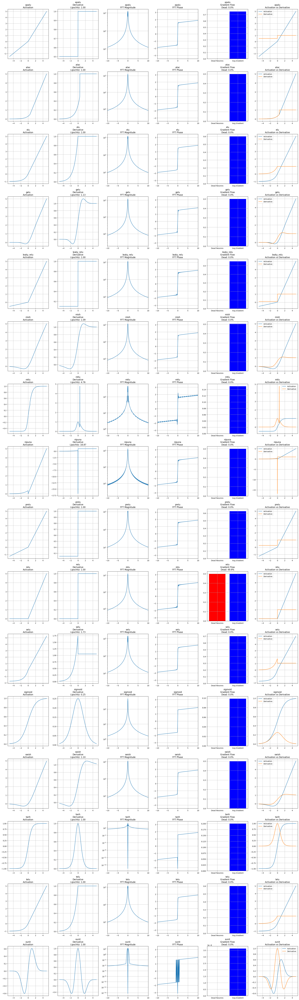

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fft import fft, fftshift
from scipy.optimize import minimize_scalar

class ActivationLibrary:
    """All AFs used in image restoration (basic to cutting-edge)"""
    @staticmethod
    def sigmoid(x):
        return 1 / (1 + np.exp(-x))

    @staticmethod
    def tanh(x):
        return np.tanh(x)

    @staticmethod
    def relu(x):
        return np.maximum(0, x)

    @staticmethod
    def leaky_relu(x, alpha=0.1):
        return np.where(x > 0, x, alpha * x)

    @staticmethod
    def prelu(x, alpha=0.25):
        return np.where(x > 0, x, alpha * x)

    @staticmethod
    def gelu(x):
        return 0.5 * x * (1 + np.tanh(np.sqrt(2/np.pi) * (x + 0.044715 * x**3)))

    @staticmethod
    def elu(x, alpha=1.0):
        return np.where(x > 0, x, alpha * (np.exp(x) - 1))

    @staticmethod
    def selu(x):
        scale = 1.0507
        alpha = 1.67326
        return scale * np.where(x > 0, x, alpha * (np.exp(x) - 1))

    @staticmethod
    def swish(x):
        return x / (1 + np.exp(-x))

    @staticmethod
    def mish(x):
        return x * np.tanh(np.log(1 + np.exp(x)))

    @staticmethod
    def xunit(x):
        """XUnit: S-shaped with learned threshold"""
        return x * np.exp(-(x**2)/2)

    @staticmethod
    def mtlu(x, threshold=0.5):
        """MTLU: Modified Tanh Unit"""
        return np.where(x > threshold, np.tanh(x), 0.5*np.tanh(2*x))

    @staticmethod
    def nipuna(x, alpha=0.5):
        """NIPUNA: Non-Increasing Piecewise Unit with Negative Adaptation"""
        return np.where(x > 0, x, alpha * np.log(1 + np.exp(x)))

    @staticmethod
    def telu(x, lambda_=1.0):
        """TeLU: Thresholded Exponential Linear Unit"""
        return np.where(x > 0, x, lambda_ * (np.exp(x) - 1))

    @staticmethod
    def atac(x, tau=0.5):
        """ATAC: Adaptive Threshold Activation"""
        return np.where(x > tau, x, tau * np.exp(x - tau))

    @staticmethod
    def apalu(x, alpha=0.5, beta=1.0):
        """APALU: Adaptive Piecewise Approximated Linear Unit"""
        return np.where(x > 0, beta * x, alpha * x)

def estimate_lipschitz(func, x_range=(-5, 5), n_samples=1000):
    """Estimate the Lipschitz constant numerically"""
    x = np.linspace(x_range[0], x_range[1], n_samples)
    y = func(x)
    dy = np.gradient(y, x)
    return np.max(np.abs(dy))

def compute_gradient_flow(func, x_range=(-5, 5), n_samples=1000):
    """Compute gradient flow characteristics"""
    x = np.linspace(x_range[0], x_range[1], n_samples)
    dy = np.gradient(func(x), x)
    dead_neurons_ratio = np.mean(dy == 0)  # Percentage of dead neurons
    avg_gradient = np.mean(dy)
    return dead_neurons_ratio, avg_gradient

# Create a grid of plots
activation_names = [name for name in dir(ActivationLibrary) if not name.startswith('__')]
num_activations = len(activation_names)

# Common input domain
x = np.linspace(-5, 5, 1000)
dx = x[1] - x[0]  # For FFT frequency calculation

# Set up the figure
plt.figure(figsize=(24, 5*num_activations))

for i, name in enumerate(activation_names):
    # Get the activation function
    func = getattr(ActivationLibrary, name)

    # Compute activation and its numerical derivative
    y = func(x)
    dy = np.gradient(y, x)

    # Compute FFT
    fft_values = fftshift(fft(y))
    freqs = fftshift(np.fft.fftfreq(len(x), dx))

    # Compute Lipschitz constant
    lipschitz = estimate_lipschitz(func)

    # Compute gradient flow
    dead_ratio, avg_grad = compute_gradient_flow(func)

    # Create subplots for each activation function
    plt.subplot(num_activations, 6, 6*i + 1)
    plt.plot(x, y)
    plt.title(f'{name}\nActivation')
    plt.grid(True)

    plt.subplot(num_activations, 6, 6*i + 2)
    plt.plot(x, dy)
    plt.title(f'{name}\nDerivative\nLipschitz: {lipschitz:.2f}')
    plt.grid(True)

    plt.subplot(num_activations, 6, 6*i + 3)
    plt.semilogy(freqs, np.abs(fft_values))
    plt.xlim(-10, 10)
    plt.title(f'{name}\nFFT Magnitude')
    plt.grid(True)

    plt.subplot(num_activations, 6, 6*i + 4)
    plt.plot(freqs, np.angle(fft_values))
    plt.xlim(-10, 10)
    plt.title(f'{name}\nFFT Phase')
    plt.grid(True)

    plt.subplot(num_activations, 6, 6*i + 5)
    plt.bar(['Dead Neurons', 'Avg Gradient'], [dead_ratio, avg_grad], color=['red', 'blue'])
    plt.title(f'{name}\nGradient Flow\nDead: {dead_ratio:.1%}')
    plt.grid(True)

    plt.subplot(num_activations, 6, 6*i + 6)
    plt.plot(x, y, label='Activation')
    plt.plot(x, dy, label='Derivative')
    plt.title(f'{name}\nActivation vs Derivative')
    plt.legend()
    plt.grid(True)

plt.tight_layout()
plt.savefig('activation_functions_analysis.png', dpi=150, bbox_inches='tight')
plt.show()

## Introduction to AFs in Image processing

## Step 1: Loading necessary libraries

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Activation, Concatenate
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
from skimage import io
from google.colab import files

# Verify GPU (if using Colab)
print("GPU Available:", tf.config.list_physical_devices('GPU'))

GPU Available: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Step 2: Base Model with Activation Visualization


In [ ]:
def build_activation_study_model(activation='relu'):
    inputs = Input(shape=(256, 256, 3))

    # Conv1 (32 channels)
    conv1 = Conv2D(32, 3, padding='same', name='conv1')(inputs)
    act1 = Activation(activation, name=f'act1_{activation}')(conv1)

    # Conv2 (64 channels)
    conv2 = Conv2D(64, 3, padding='same', name='conv2')(act1)
    act2 = Activation(activation, name=f'act2_{activation}')(conv2)

    # Output (3 channels)
    output = Conv2D(3, 3, padding='same', activation='linear')(act2)

    return Model(inputs, [conv1, act1, conv2, act2, output])

## Visualization (Part -1)

In [ ]:
def plot_channels(tensor, title=""):
    """Plot all channels of a 4D tensor in a grid."""
    n_channels = tensor.shape[-1]
    cols = 8
    rows = int(np.ceil(n_channels / cols))

    plt.figure(figsize=(cols*2, rows*2))
    plt.suptitle(f"{title} (Channels: {n_channels})", y=1.05)

    for i in range(n_channels):
        plt.subplot(rows, cols, i+1)
        channel = tensor[0, :, :, i]
        plt.imshow(channel, cmap='gray')
        plt.axis('off')
        plt.title(f"{i}", fontsize=8)

    plt.tight_layout()
    plt.show()

def plot_rgb_comparison(preact, postact, title=""):
    """Compare first 3 channels as RGB-like images."""
    plt.figure(figsize=(12, 6))

    # Pre-activation (first 3 channels)
    plt.subplot(1, 2, 1)
    plt.title(f"Before {title}\n(Channels 0-2)")
    plt.imshow(preact[0, :, :, :3])
    plt.axis('off')

    # Post-activation (first 3 channels)
    plt.subplot(1, 2, 2)
    plt.title(f"After {title}\n(Channels 0-2)")
    plt.imshow(postact[0, :, :, :3])
    plt.axis('off')

    plt.tight_layout()
    plt.show()

## Step 4: Load Test Image


Saving CT.png to CT.png


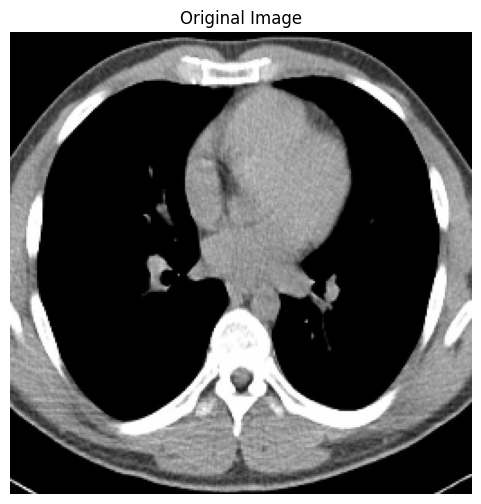

In [ ]:
# Upload and preprocess
uploaded = files.upload()
img_path = list(uploaded.keys())[0]
original_img = io.imread(img_path)[:, :, :3]  # Force 3 channels if RGBA
original_img = original_img / 255.0  # Normalize to [0,1]

# Resize and add batch dimension
img = tf.image.resize(original_img, (256, 256)).numpy()
img_batch = np.expand_dims(img, axis=0)  # Shape: (1, 256, 256, 3)

# Display original
plt.figure(figsize=(6, 6))
plt.title("Original Image")
plt.imshow(img)
plt.axis('off')
plt.show()

## Step 5: Compare Activations


In [ ]:
activations = ['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']

for act in activations:
    print(f"\n\033[1m=== {act.upper()} ===\033[0m")
    model = build_activation_study_model(activation=act)
    conv1, act1, conv2, act2, output = model.predict(img_batch, verbose=0)

    # Convert to tensors
    conv1 = tf.convert_to_tensor(conv1)
    act1 = tf.convert_to_tensor(act1)
    conv2 = tf.convert_to_tensor(conv2)
    act2 = tf.convert_to_tensor(act2)

    # Layer 1 Visualizations
    print("\n\033[1mLayer 1 (32 channels)\033[0m")
    plot_rgb_comparison(conv1, act1, title=f"{act.upper()} (Layer 1)")
    plot_channels(conv1, "Pre-Activation (All Channels)")
    plot_channels(act1, "Post-Activation (All Channels)")

    # Layer 2 Visualizations
    print("\n\033[1mLayer 2 (64 channels)\033[0m")
    plot_rgb_comparison(conv2, act2, title=f"{act.upper()} (Layer 2)")
    plot_channels(conv2, "Pre-Activation (All Channels)")
    plot_channels(act2, "Post-Activation (All Channels)")

    # Final Output
    plt.figure(figsize=(6, 6))
    plt.title(f"Final Output ({act.upper()})")
    plt.imshow(output[0].clip(0, 1))
    plt.axis('off')
    plt.show()

## Cannel-wise comparison

In [ ]:
def plot_channel_comparison(preact, postact, title="", max_channels=16):
    """Plots pre/post/diff for each channel in a vertical stack"""
    n_channels = min(preact.shape[-1], max_channels)  # Limit channels for visibility

    # Setup figure
    fig = plt.figure(figsize=(10, n_channels*3))
    fig.suptitle(f"Channel-wise Comparison: {title}", y=1.02)

    # Plot each channel in a row
    for i in range(n_channels):
        # Pre-activation
        ax1 = plt.subplot(n_channels, 3, i*3 + 1)
        plt.imshow(preact[0, :, :, i], cmap='gray')
        plt.title(f"Channel {i}\nPre-Act", fontsize=9)
        plt.axis('off')

        # Post-activation
        ax2 = plt.subplot(n_channels, 3, i*3 + 2)
        plt.imshow(postact[0, :, :, i], cmap='gray')
        plt.title(f"Post-{title}", fontsize=9)
        plt.axis('off')

        # Difference
        ax3 = plt.subplot(n_channels, 3, i*3 + 3)
        diff = np.abs(postact[0, :, :, i] - preact[0, :, :, i])
        plt.imshow(diff, cmap='hot')
        plt.title(f"Δ (max={diff.max():.2f})", fontsize=9)
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# ======================
# Modified Experiment Loop
# ======================
activations = ['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']

for act in activations:
    print(f"\n\033[1m=== {act.upper()} ===\033[0m")
    model = build_activation_study_model(activation=act)
    conv1, act1, conv2, act2, output = model.predict(img_batch, verbose=0)

    # Layer 1 (32 channels)
    print("\n\033[1mLayer 1 (First 16/32 channels)\033[0m")
    plot_channel_comparison(conv1, act1, title=act.upper())

    # Layer 2 (64 channels)
    print("\n\033[1mLayer 2 (First 16/64 channels)\033[0m")
    plot_channel_comparison(conv2, act2, title=act.upper())

    # Final output
    plt.figure(figsize=(6,6))
    plt.imshow(output[0].clip(0,1))
    plt.title(f"Final Output ({act.upper()})")
    plt.axis('off')
    plt.show()

## Visualizations with pixel distributions

In [ ]:
import seaborn as sns

def plot_activation_analysis(preact, postact, title=""):
    """Unified visualization: Images, differences, and distributions"""
    plt.figure(figsize=(18, 12))

    # Select representative channels (first, middle, last)
    channels = [0, preact.shape[-1]//2, -1]
    n_channels = len(channels)

    for i, ch in enumerate(channels):
        # Get channel data
        pre_ch = preact[0, :, :, ch]
        post_ch = postact[0, :, :, ch]
        diff = np.abs(post_ch - pre_ch)

        # -------------------------------------
        # Image Comparison (3 columns per channel)
        # -------------------------------------
        # Pre-Activation Image
        plt.subplot(n_channels, 6, i*6 + 1)
        plt.imshow(pre_ch, cmap='gray')
        plt.title(f"Ch {ch}: Pre-Act", fontsize=10)
        plt.axis('off')

        # Post-Activation Image
        plt.subplot(n_channels, 6, i*6 + 2)
        plt.imshow(post_ch, cmap='gray')
        plt.title(f"Post-{title}", fontsize=10)
        plt.axis('off')

        # Difference Map
        plt.subplot(n_channels, 6, i*6 + 3)
        plt.imshow(diff, cmap='hot')
        plt.title(f"Δ (max={diff.max():.2f})", fontsize=10)
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.axis('off')

        # -------------------------------------
        # Distribution Comparison (3 columns per channel)
        # -------------------------------------
        plt.subplot(n_channels, 6, i*6 + 4)
        sns.histplot(pre_ch.flatten(), bins=50, color='blue', kde=True,
                    stat='density', label='Pre-Act')
        sns.histplot(post_ch.flatten(), bins=50, color='orange', kde=True,
                    stat='density', label='Post-Act')
        plt.title(f"Value Distribution\nCh {ch}", fontsize=10)
        plt.xlabel('Activation Value')
        plt.legend()

        # -------------------------------------
        # Violin Plot Comparison
        # -------------------------------------
        plt.subplot(n_channels, 6, i*6 + 5)
        sns.violinplot(data=[pre_ch.flatten(), post_ch.flatten()],
                      palette=['blue', 'orange'])
        plt.xticks([0, 1], ['Pre-Act', 'Post-Act'])
        plt.title(f"Value Spread\nCh {ch}", fontsize=10)
        plt.ylabel('Activation Value')

        # -------------------------------------
        # Scatter Plot (Pre vs Post)
        # -------------------------------------
        plt.subplot(n_channels, 6, i*6 + 6)
        plt.scatter(pre_ch.flatten(), post_ch.flatten(),
                   alpha=0.1, color='green', s=2)
        plt.plot([pre_ch.min(), pre_ch.max()],
                [post_ch.min(), post_ch.max()], 'r--')
        plt.xlabel('Pre-Activation')
        plt.ylabel('Post-Activation')
        plt.title(f"Activation Mapping\nCh {ch}", fontsize=10)

    plt.tight_layout()
    plt.suptitle(f"Activation Analysis: {title}", y=1.02, fontsize=14)
    plt.show()

# ======================
# AF Selection Loop (updatable with more from previouly defined)
# ======================
activations = ['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']

for act in activations:
    print(f"\n\033[1m=== {act.upper()} ===\033[0m")
    model = build_activation_study_model(activation=act)
    conv1, act1, conv2, act2, output = model.predict(img_batch, verbose=0)

    # Layer 1 Analysis
    print("\n\033[1mLayer 1 Analysis\033[0m")
    plot_activation_analysis(conv1, act1, title=f"{act.upper()} (Layer 1)")

    # Layer 2 Analysis
    print("\n\033[1mLayer 2 Analysis\033[0m")
    plot_activation_analysis(conv2, act2, title=f"{act.upper()} (Layer 2)")

## Activation impact map


=== RELU ===

Layer 1 Impact Locations


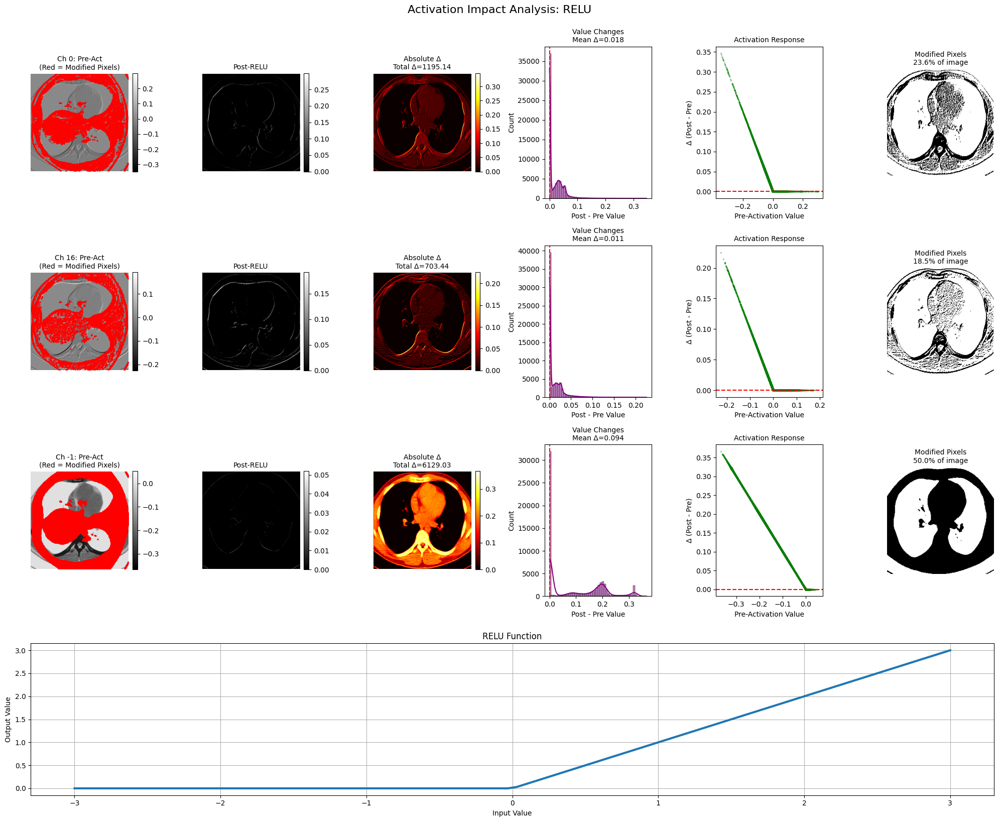


Layer 2 Impact Locations


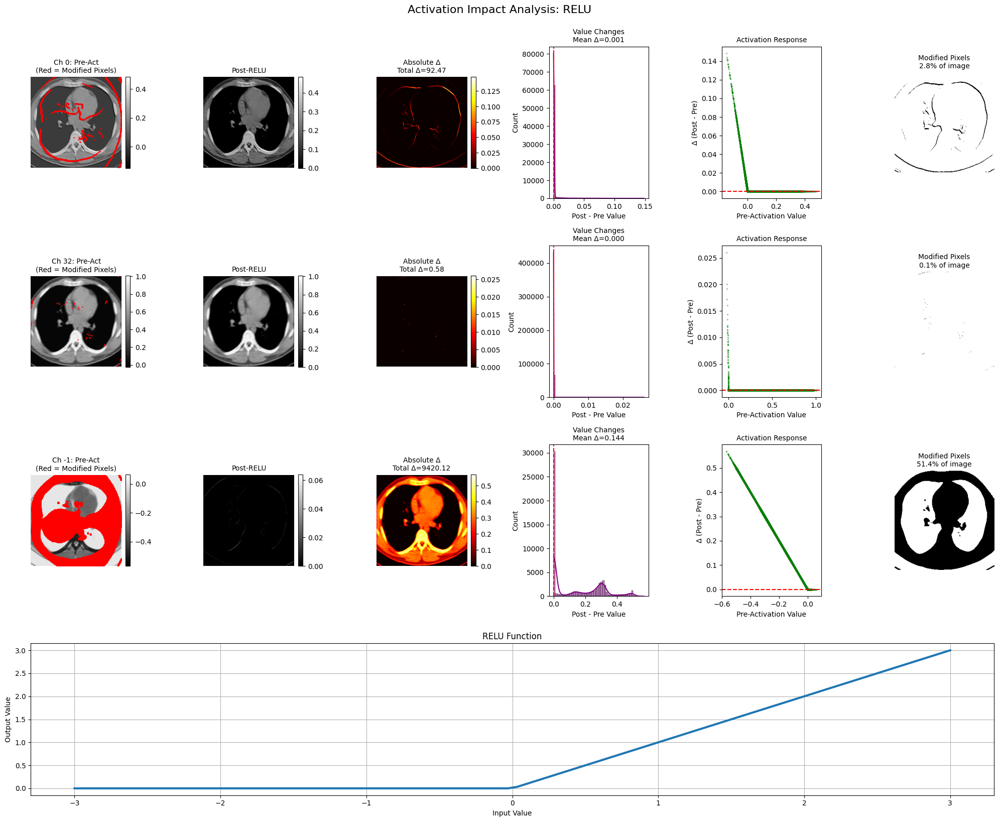


=== LEAKY_RELU ===

Layer 1 Impact Locations


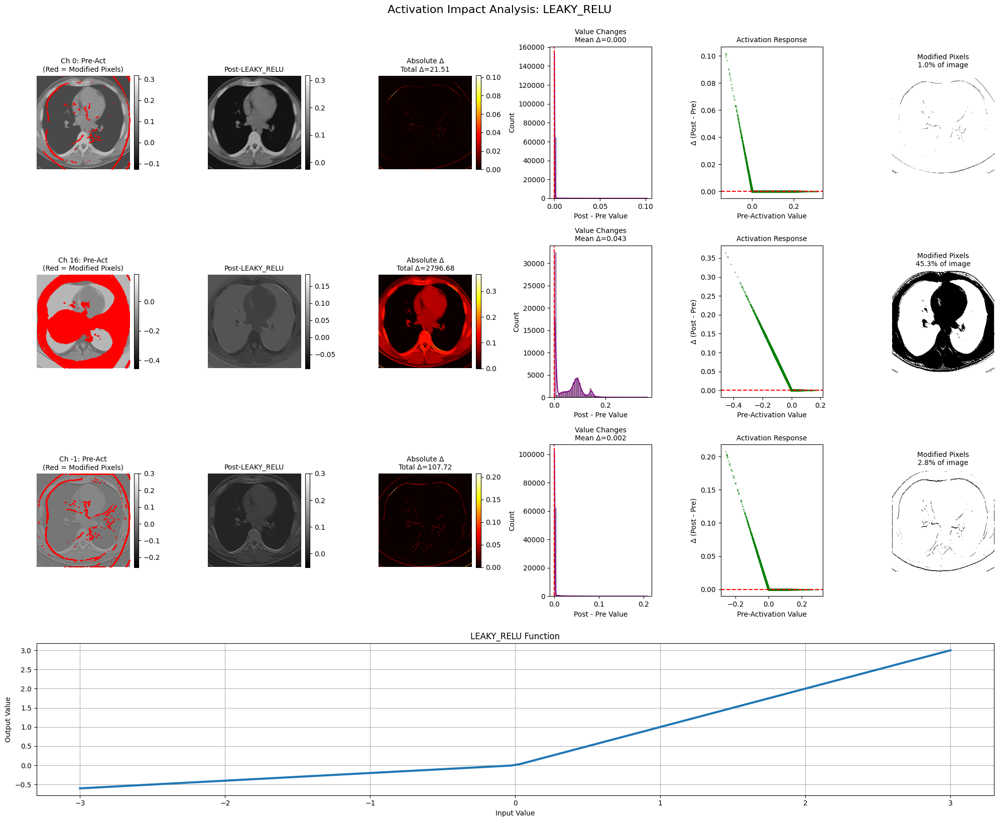


Layer 2 Impact Locations


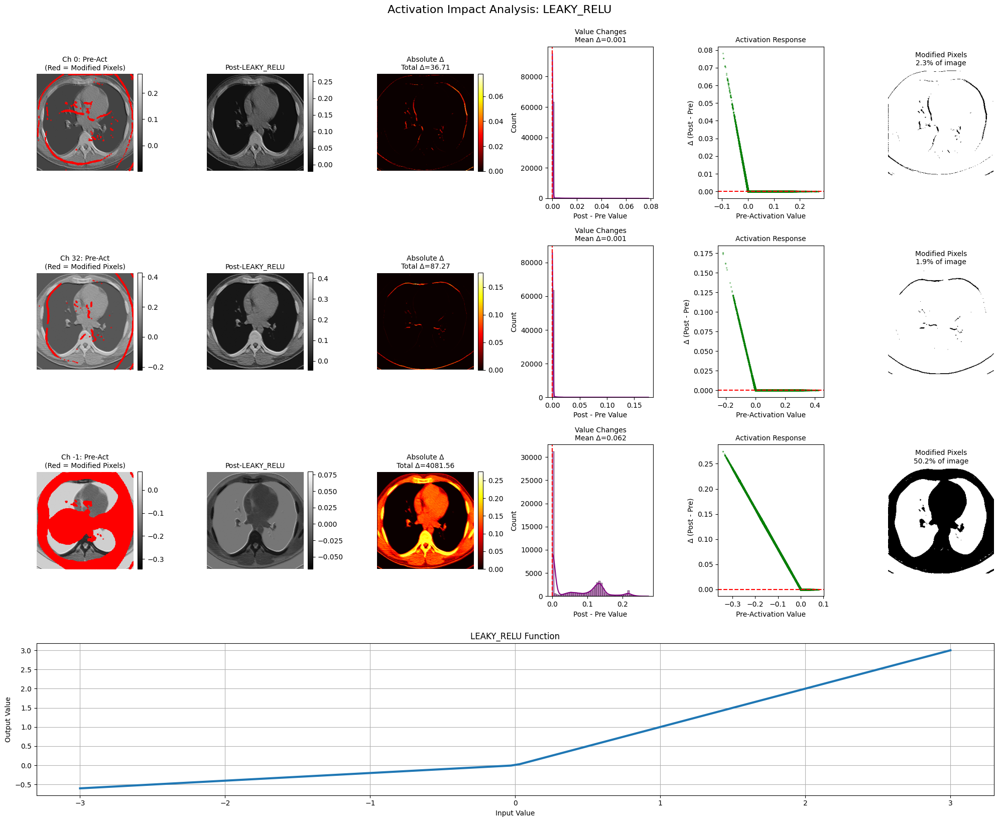


=== SIGMOID ===

Layer 1 Impact Locations


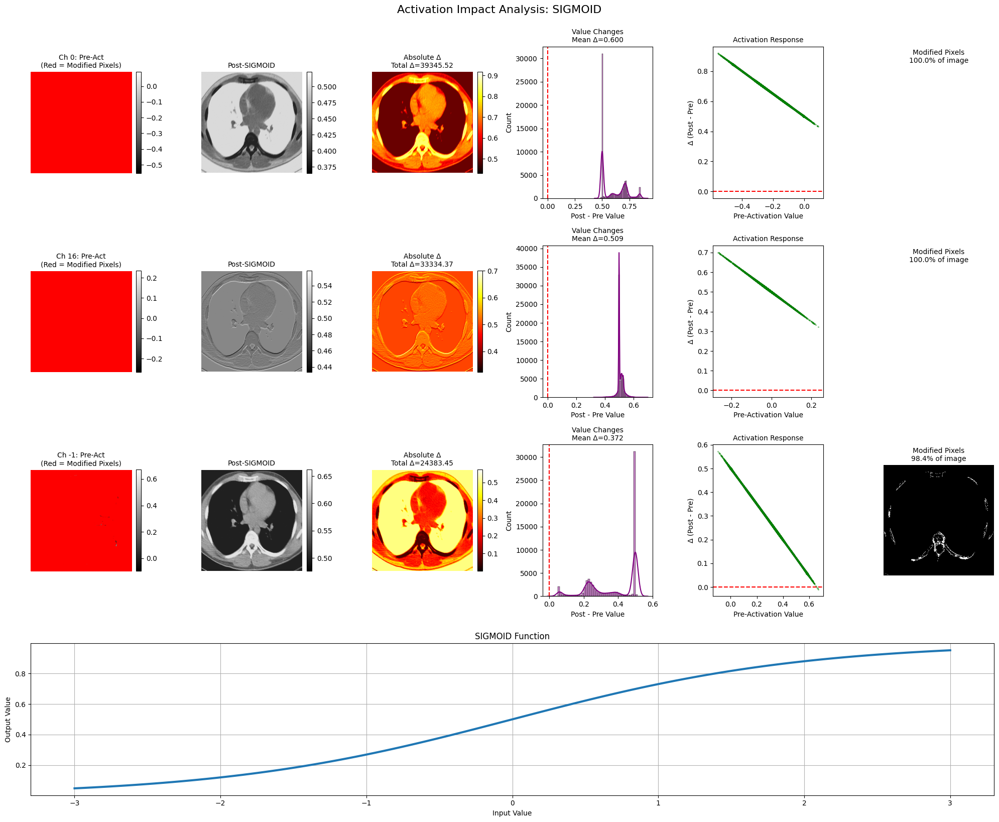


Layer 2 Impact Locations


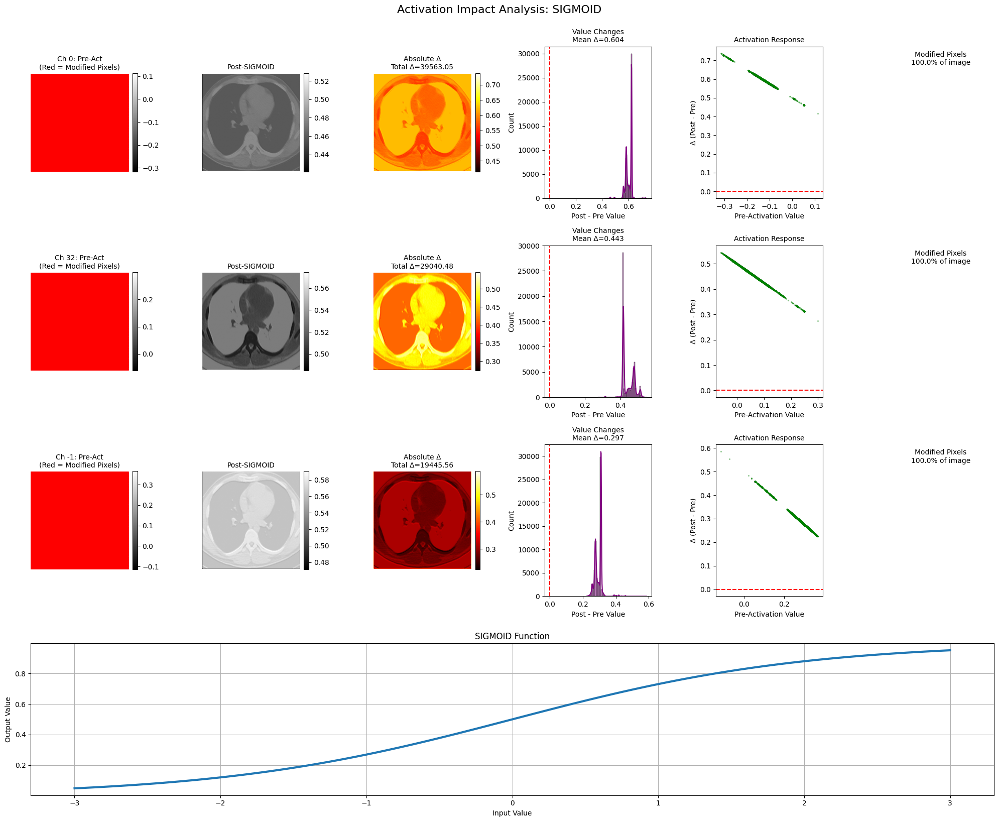


=== TANH ===

Layer 1 Impact Locations


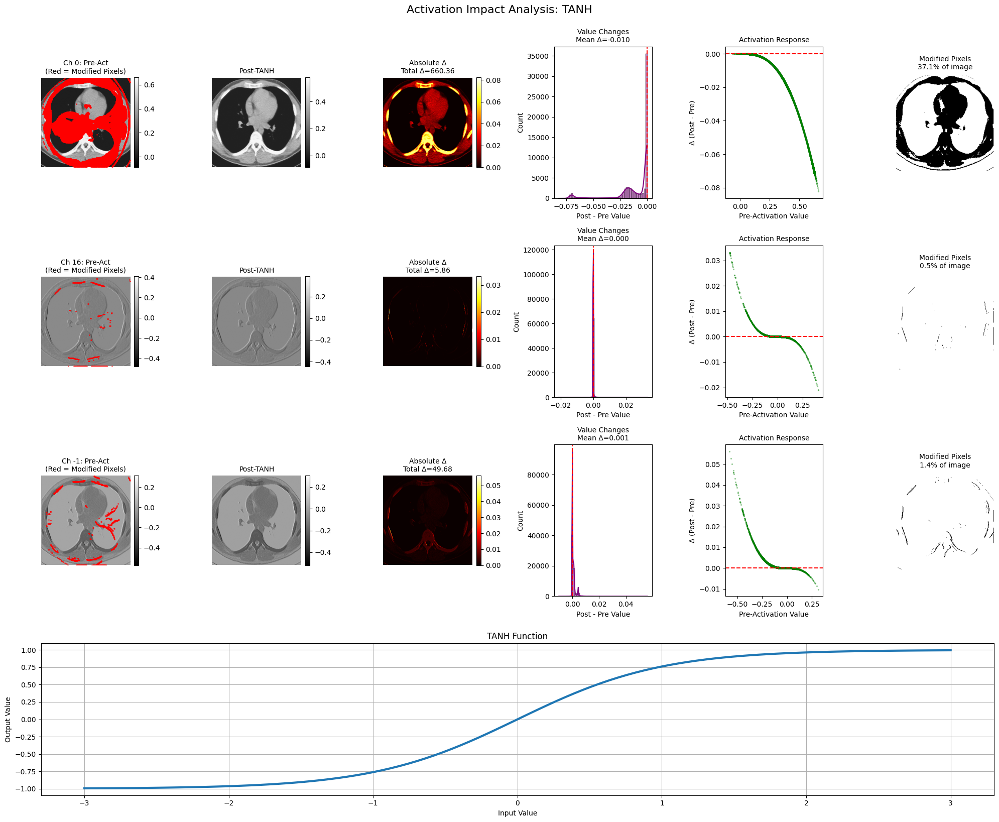


Layer 2 Impact Locations


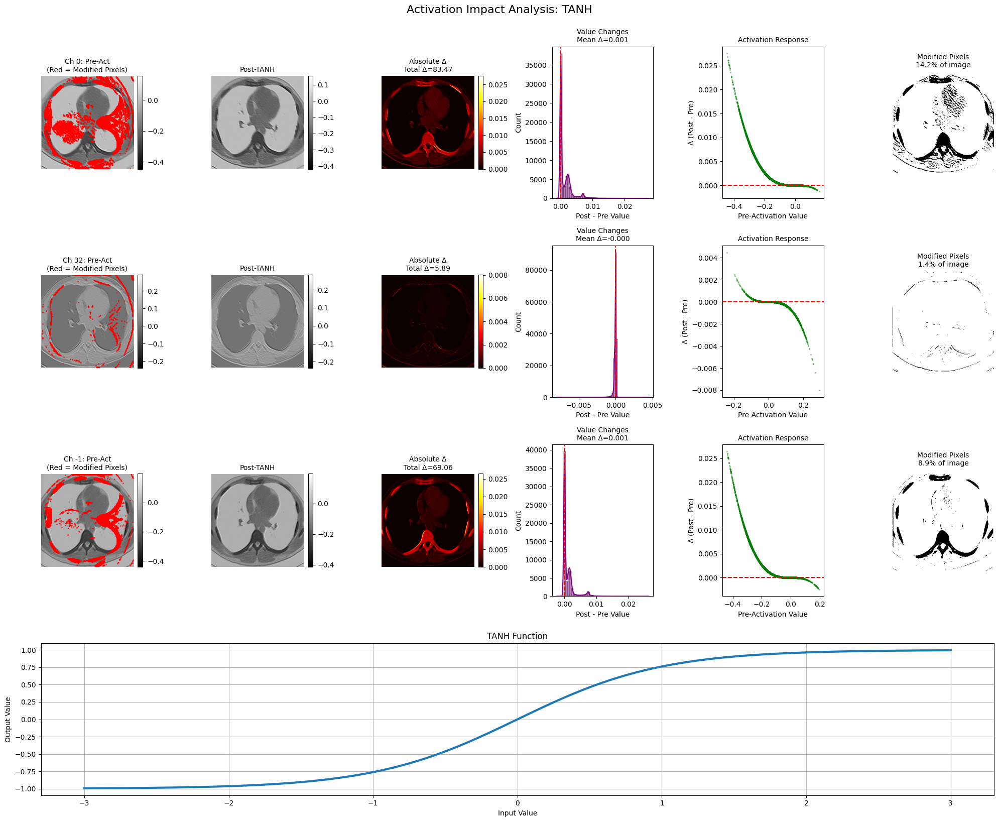


=== SWISH ===

Layer 1 Impact Locations


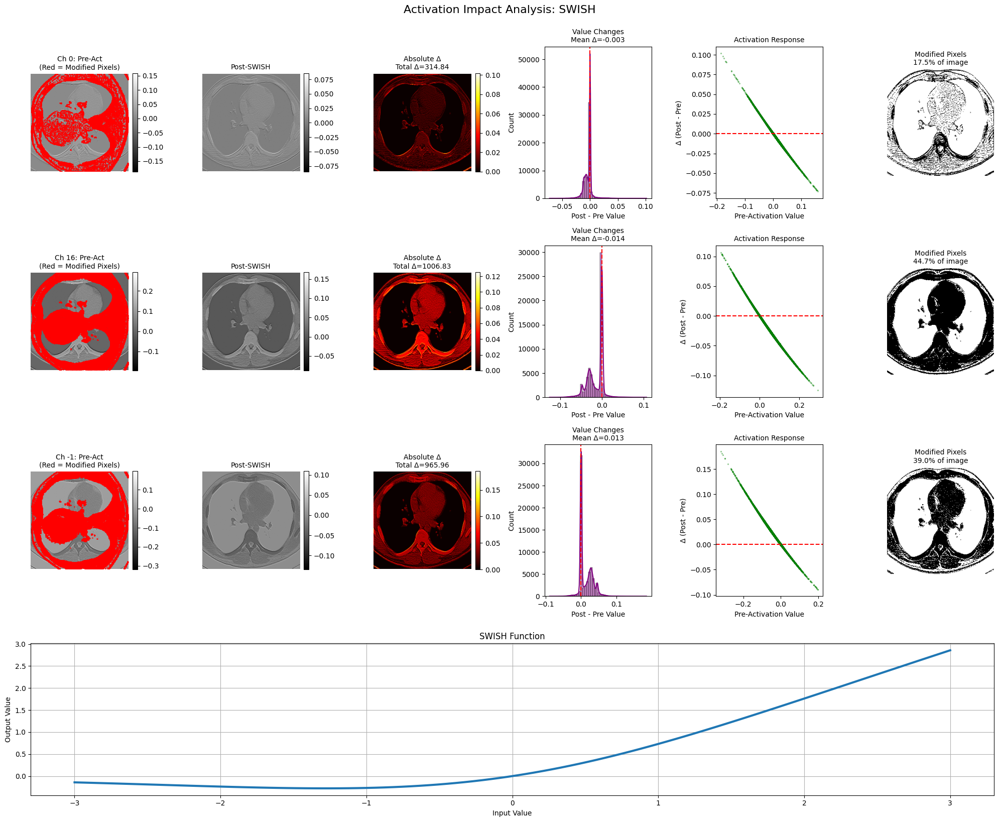


Layer 2 Impact Locations


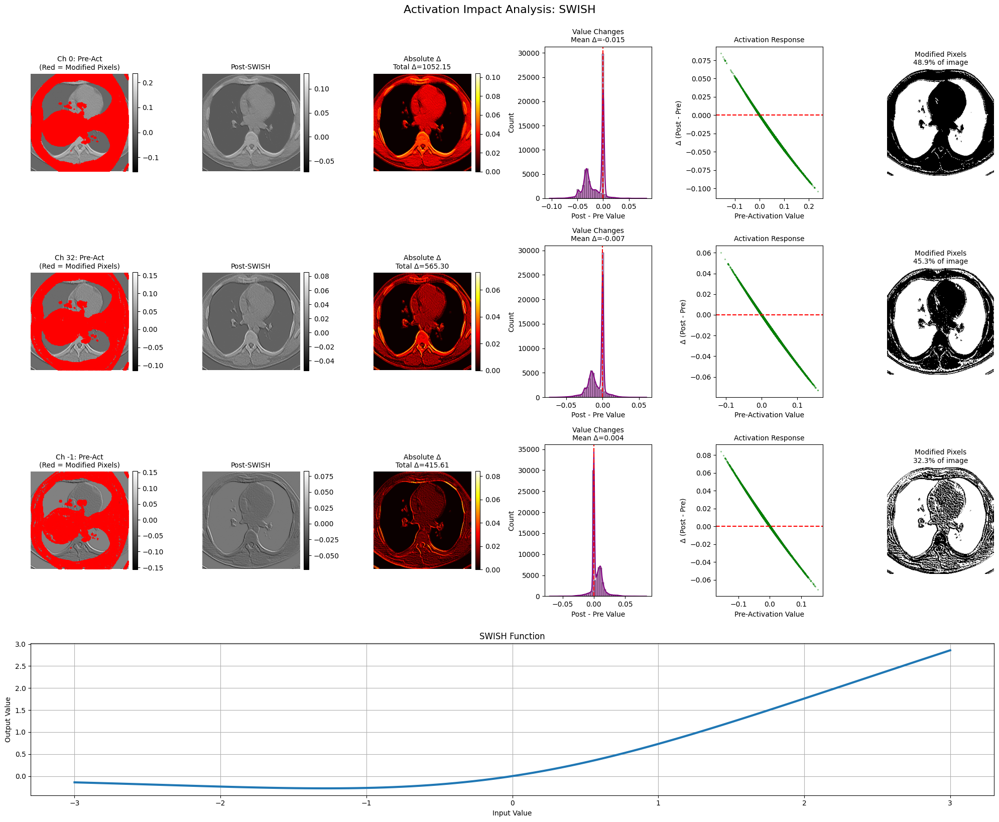

In [ ]:
def plot_activation_impact_locations(preact, postact, title=""):
    """Visualizes EXACTLY WHERE activations modify values with statistical insights"""
    plt.figure(figsize=(20, 16))

    # Select representative channels
    channels = [0, preact.shape[-1]//2, -1]  # First, middle, last channel

    for i, ch in enumerate(channels):
        pre_ch = preact[0, :, :, ch]
        post_ch = postact[0, :, :, ch]
        diff = post_ch - pre_ch
        abs_diff = np.abs(diff)

        # -------------------------------------
        # Spatial Modifications (Column 1-3)
        # -------------------------------------
        # 1. Preactivation with modification spots
        plt.subplot(4, 6, i*6 + 1)
        plt.imshow(pre_ch, cmap='gray')
        plt.colorbar(fraction=0.046, pad=0.04)
        # Highlight pixels where activation changed values significantly
        threshold = 0.1 * np.max(abs_diff)  # 10% of max change
        modified_mask = abs_diff > threshold
        plt.scatter(*np.where(modified_mask), color='red', s=1, alpha=0.7)
        plt.title(f"Ch {ch}: Pre-Act\n(Red = Modified Pixels)", fontsize=10)
        plt.axis('off')

        # 2. Postactivation with modification intensity
        plt.subplot(4, 6, i*6 + 2)
        plt.imshow(post_ch, cmap='gray')
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.title(f"Post-{title}", fontsize=10)
        plt.axis('off')

        # 3. statistical distributions-heatmat
        plt.subplot(4, 6, i*6 + 3)
        plt.imshow(abs_diff, cmap='hot')
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.title(f"Absolute Δ\nTotal Δ={np.sum(abs_diff):.2f}", fontsize=10)
        plt.axis('off')

        # -------------------------------------
        # Stat-analysis (Column 4-6)
        # -------------------------------------
        # 4. Distribution of changes
        plt.subplot(4, 6, i*6 + 4)
        sns.histplot(diff.flatten(), bins=50, kde=True, color='purple')
        plt.axvline(0, color='red', linestyle='--')
        plt.title(f"Value Changes\nMean Δ={diff.mean():.3f}", fontsize=10)
        plt.xlabel('Post - Pre Value')

        # 5. Modification spots -scatter
        plt.subplot(4, 6, i*6 + 5)
        plt.scatter(pre_ch.flatten(), diff.flatten(),
                   alpha=0.3, c='green', s=2)
        plt.axhline(0, color='red', linestyle='--')
        plt.xlabel('Pre-Activation Value')
        plt.ylabel('Δ (Post - Pre)')
        plt.title(f"Activation Response", fontsize=10)

        # 6. Binary modification plot
        plt.subplot(4, 6, i*6 + 6)
        plt.imshow(modified_mask, cmap='binary')
        plt.title(f"Modified Pixels\n{modified_mask.mean():.1%} of image", fontsize=10)
        plt.axis('off')

    # -------------------------------------
    # AF plots (last row)
    # -------------------------------------
    x = np.linspace(-3, 3, 100)
    activations = {
        'relu': np.maximum(0, x),
        'leaky_relu': np.where(x > 0, x, 0.2*x),
        'sigmoid': 1/(1+np.exp(-x)),
        'tanh': np.tanh(x),
        'swish': x/(1+np.exp(-x))
    }

    plt.subplot(4, 1, 4)
    plt.plot(x, activations.get(title.lower(), x), linewidth=3)
    plt.title(f"{title} Function", fontsize=12)
    plt.xlabel('Input Value')
    plt.ylabel('Output Value')
    plt.grid(True)

    plt.tight_layout()
    plt.suptitle(f"Activation Impact Analysis: {title}", y=1.02, fontsize=16)
    plt.show()

## --execution loop--
for act in activations:
    print(f"\n\033[1m=== {act.upper()} ===\033[0m")
    model = build_activation_study_model(activation=act)
    conv1, act1, conv2, act2, output = model.predict(img_batch, verbose=0)

    print("\n\033[1mLayer 1 Impact Locations\033[0m")
    plot_activation_impact_locations(conv1, act1, title=act.upper())

    print("\n\033[1mLayer 2 Impact Locations\033[0m")
    plot_activation_impact_locations(conv2, act2, title=act.upper())

### Single layer plots

In [ ]:
import matplotlib.gridspec as gridspec

def compare_activations_side_by_single_layer(preact_dict, postact_dict, layer_name):
    """Compares ALL activations for ONE layer in a unified view"""
    activations = list(preact_dict.keys())
    n_activations = len(activations)
    n_channels = min(preact_dict[activations[0]].shape[-1], 16)  # Limit to 16 channels

    # Create mega-figure
    fig = plt.figure(figsize=(24, 4 * n_channels))
    gs = gridspec.GridSpec(n_channels, n_activations * 3, figure=fig)

    fig.suptitle(f'Activation Function Comparison: {layer_name}', y=1.02, fontsize=16)

    for ch in range(n_channels):
        for i, act in enumerate(activations):
            pre_ch = preact_dict[act][0, :, :, ch]
            post_ch = postact_dict[act][0, :, :, ch]
            diff = np.abs(post_ch - pre_ch)

            # Pre-Activation
            ax = plt.subplot(gs[ch, i*3])
            plt.imshow(pre_ch, cmap='gray')
            if ch == 0:
                plt.title(f"{act.upper()}\nPre-Act", fontsize=10)
            plt.axis('off')

            # Post-Activation
            ax = plt.subplot(gs[ch, i*3 + 1])
            plt.imshow(post_ch, cmap='gray')
            if ch == 0:
                plt.title("Post-Act", fontsize=10)
            plt.axis('off')

            # Difference
            ax = plt.subplot(gs[ch, i*3 + 2])
            plt.imshow(diff, cmap='hot')
            if ch == 0:
                plt.title(f"Δ (max={diff.max():.2f})", fontsize=10)
            plt.colorbar(fraction=0.04, pad=0.04)
            plt.axis('off')

    plt.tight_layout()
    plt.show()

def compare_activations_side_by_single_channel(preact_dict, postact_dict, layer_name, channel=0):
    """Compares ALL activations for ONE channel across functions"""
    activations = list(preact_dict.keys())
    n_activations = len(activations)

    fig = plt.figure(figsize=(24, 8))
    gs = gridspec.GridSpec(3, n_activations, figure=fig)
    fig.suptitle(f'Activation Comparison: {layer_name} Channel {channel}', y=1.05, fontsize=16)

    for i, act in enumerate(activations):
        pre_ch = preact_dict[act][0, :, :, channel]
        post_ch = postact_dict[act][0, :, :, channel]
        diff = post_ch - pre_ch

        # Image View
        ax = plt.subplot(gs[0, i])
        plt.imshow(post_ch, cmap='gray')
        plt.title(f"{act.upper()}", fontsize=12)
        plt.axis('off')

        # Value Distribution
        ax = plt.subplot(gs[1, i])
        sns.kdeplot(pre_ch.flatten(), color='blue', label='Pre')
        sns.kdeplot(post_ch.flatten(), color='orange', label='Post')
        plt.legend()
        plt.xlabel('Value')

        # Activation Response
        ax = plt.subplot(gs[2, i])
        plt.scatter(pre_ch.flatten(), diff.flatten(), alpha=0.2, s=2)
        plt.axhline(0, color='red', linestyle='--')
        plt.xlabel('Pre Value')
        plt.ylabel('Δ (Post - Pre)')

    plt.tight_layout()
    plt.show()


activations = ['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']
layer_names = ['Layer1 (32ch)', 'Layer2 (64ch)']

# Process all activations
preact_dict_l1 = {}
postact_dict_l1 = {}
preact_dict_l2 = {}
postact_dict_l2 = {}

for act in activations:
    model = build_activation_study_model(activation=act)
    conv1, act1, conv2, act2, _ = model.predict(img_batch, verbose=0)
    preact_dict_l1[act] = conv1
    postact_dict_l1[act] = act1
    preact_dict_l2[act] = conv2
    postact_dict_l2[act] = act2

# Compare Layer 1
print("\n\033[1m=== LAYER 1 COMPARISON ===\033[0m")
compare_activations_side_by_single_layer(preact_dict_l1, postact_dict_l1, layer_names[0])

# Compare Layer 2
print("\n\033[1m=== LAYER 2 COMPARISON ===\033[0m")
compare_activations_side_by_single_layer(preact_dict_l2, postact_dict_l2, layer_names[1])

# Compare specific channel across activations
print("\n\033[1m=== CHANNEL-WISE COMPARISON ===\033[0m")
for ch in [0, 8, 15]:  # First, middle, last channel
    compare_activations_side_by_single_channel(preact_dict_l1, postact_dict_l1,
                                             f"{layer_names[0]} Ch{ch}", channel=ch)

## AF Impact visualization

In [ ]:
def compare_activations_with_impact_points(preact_dict, postact_dict, layer_name, channel=0, threshold=0.1):
    """
    Compares ALL activation functions for ONE channel, highlighting EXACT modification points
    with statistical insights
    """
    activations = list(preact_dict.keys())
    n_activations = len(activations)

    # Create figure with custom grid
    fig = plt.figure(figsize=(24, 10))
    gs = gridspec.GridSpec(4, n_activations, figure=fig, height_ratios=[1, 1, 1, 0.4])
    fig.suptitle(f'Activation Impact Comparison: {layer_name} Channel {channel}', y=1.05, fontsize=16)

    for i, act in enumerate(activations):
        pre_ch = preact_dict[act][0, :, :, channel]
        post_ch = postact_dict[act][0, :, :, channel]
        diff = post_ch - pre_ch
        abs_diff = np.abs(diff)

        # -------------------------------------
        # 1. Preactivation with impact points
        # -------------------------------------
        ax1 = plt.subplot(gs[0, i])
        im = plt.imshow(pre_ch, cmap='gray')
        plt.colorbar(im, fraction=0.046, pad=0.04)

        # Mark impact points in red spots (where activation changed values significantly)
        modified_mask = abs_diff > (threshold * abs_diff.max())
        y, x = np.where(modified_mask)
        plt.scatter(x, y, color='red', s=5, alpha=0.7,
                  label=f'{modified_mask.mean():.1%} modified')
        plt.title(f"{act.upper()}\nPre-Act + Impact Points", fontsize=12)
        plt.axis('off')
        plt.legend(loc='upper right')

        # -------------------------------------
        # 2. Postactivation with modification Intensity
        # -------------------------------------
        ax2 = plt.subplot(gs[1, i])
        im = plt.imshow(post_ch, cmap='gray')
        plt.colorbar(im, fraction=0.046, pad=0.04)
        plt.title("Post-Activation", fontsize=12)
        plt.axis('off')

        # -------------------------------------
        # 3. Difference heatmap with threshold
        # -------------------------------------
        ax3 = plt.subplot(gs[2, i])
        im = plt.imshow(abs_diff, cmap='hot',
                      vmax=abs_diff.max(), vmin=0)
        plt.colorbar(im, fraction=0.046, pad=0.04)

        # Overlay threshold contour
        plt.contour(modified_mask, levels=[0.5], colors='cyan', linewidths=1)
        plt.title(f"Absolute Δ\n(Threshold = {threshold:.0%} of max)", fontsize=12)
        plt.axis('off')

        # -------------------------------------
        # 4. Activation response curve
        # -------------------------------------
        ax4 = plt.subplot(gs[3, i])
        x_range = np.linspace(pre_ch.min(), pre_ch.max(), 100)

        # Plot theoretical activation
        if act == 'relu':
            y_range = np.maximum(0, x_range)
        elif act == 'leaky_relu':
            y_range = np.where(x_range > 0, x_range, 0.2*x_range)
        elif act == 'sigmoid':
            y_range = 1/(1+np.exp(-x_range))
        elif act == 'tanh':
            y_range = np.tanh(x_range)
        elif act == 'swish':
            y_range = x_range/(1+np.exp(-x_range))

        plt.plot(x_range, y_range, 'r-', lw=2)

        # Plot empirical changes
        plt.scatter(pre_ch.flatten(), diff.flatten(),
                   alpha=0.1, color='blue', s=5, label='Empirical Δ')
        plt.axhline(0, color='black', linestyle='--')
        plt.xlabel('Pre-Act Value')
        plt.ylabel('Δ (Post - Pre)')
        plt.grid(True)

    plt.tight_layout()
    plt.show()


print("\n\033[1m=== IMPACT POINT ANALYSIS ===\033[0m")
for ch in [0, 8, 15]:  # First, middle, last channel
    compare_activations_with_impact_points(
        preact_dict_l1,
        postact_dict_l1,
        layer_name=f"{layer_names[0]} Ch{ch}",
        channel=ch,
        threshold=0.1  # 10% of max difference as impact threshold
    )

## Comprehensive analysis

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec
from skimage import io
from scipy.stats import gaussian_kde
from tensorflow.keras.layers import Layer # Import Layer

plt.rcParams.update({
    'font.size': 12,
    'axes.titlesize': 14,
    'axes.labelsize': 12,
    'xtick.labelsize': 10,
    'ytick.labelsize': 10,
    'figure.dpi': 300,
    'savefig.dpi': 300,
    'font.family': 'serif',
    'figure.autolayout': True
})

# Custom Keras Layer for Depth to Space
class DepthToSpace(Layer):
    def __init__(self, block_size, **kwargs):
        super(DepthToSpace, self).__init__(**kwargs)
        self.block_size = block_size

    def call(self, inputs):
        return tf.nn.depth_to_space(inputs, self.block_size)

    def get_config(self):
        config = super(DepthToSpace, self).get_config()
        config.update({'block_size': self.block_size})
        return config

# =============================================
# 1. Theoretical Analysis (Mathematical Properties)
# =============================================
def plot_activation_functions():
    """Plots all activation functions with key properties"""
    x = np.linspace(-3, 3, 500)
    activations = {
        'ReLU': np.maximum(0, x),
        'LeakyReLU': np.where(x > 0, x, 0.1*x),
        'Sigmoid': 1/(1+np.exp(-x)),
        'Tanh': np.tanh(x),
        'Swish': x/(1+np.exp(-x)),
        'ELU': np.where(x > 0, x, np.exp(x)-1)
    }

    fig = plt.figure(figsize=(15, 8))
    gs = GridSpec(2, 3, figure=fig)

    # Main function plots
    ax_main = fig.add_subplot(gs[0, :])
    for name, y in activations.items():
        ax_main.plot(x, y, label=name, lw=2.5)
    ax_main.set_title("Activation Functions", pad=20)
    ax_main.set_xlabel("Input")
    ax_main.set_ylabel("Output")
    ax_main.legend(loc='upper left', bbox_to_anchor=(1, 1))
    ax_main.grid(True, alpha=0.3)

    # Derivatives
    ax_deriv = fig.add_subplot(gs[1, 0])
    for name, y in activations.items():
        dy = np.gradient(y, x[1]-x[0])
        ax_deriv.plot(x, dy, label=name, lw=2)
    ax_deriv.set_title("First Derivatives")
    ax_deriv.set_xlabel("Input")
    ax_deriv.set_ylabel("dy/dx")
    ax_deriv.grid(True, alpha=0.3)

    # Second Derivatives
    ax_deriv2 = fig.add_subplot(gs[1, 1])
    for name, y in activations.items():
        dy = np.gradient(np.gradient(y, x[1]-x[0]), x[1]-x[0])
        ax_deriv2.plot(x, dy, label=name, lw=2)
    ax_deriv2.set_title("Second Derivatives")
    ax_deriv2.set_xlabel("Input")
    ax_deriv2.grid(True, alpha=0.3)

    # Dead Neuron Analysis
    ax_dead = fig.add_subplot(gs[1, 2])
    dead_ratios = {
        'ReLU': np.mean(np.maximum(0, x) == 0),
        'LeakyReLU': np.mean(np.where(x > 0, x, 0.1*x) == 0),
        'Sigmoid': 0,
        'Tanh': 0,
        'Swish': np.mean(x/(1+np.exp(-x)) == 0)
    }
    ax_dead.bar(dead_ratios.keys(), dead_ratios.values(), color='darkred')
    ax_dead.set_title("Dead Neuron Ratio (x ~ N(0,1))")
    ax_dead.set_ylabel("Fraction of Zero Outputs")
    plt.xticks(rotation=45)

    plt.tight_layout()
    plt.savefig("activation_properties.pdf", bbox_inches='tight')
    plt.show()

# =============================================
# 2. Empirical Impact Analysis (Feature Space)
# =============================================
def plot_empirical_impact(image_path, activations=['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']):
    """Analyzes activation impacts on real feature maps"""
    # Load and preprocess image
    img = io.imread(image_path)[:,:,:3]/255.0
    img = tf.image.resize(img, [256,256]).numpy()
    img_batch = img[np.newaxis, ...]

    # Build test model
    def build_test_model(activation):
        inputs = Input(shape=(256,256,3))
        x = Conv2D(32, 3, padding='same')(inputs)
        x = Activation(activation)(x)
        x = Conv2D(64, 3, padding='same')(x)
        x = Activation(activation)(x)
        # Use the custom layer for depth_to_space
        x = Conv2D(64 * (2 ** 2), 3, padding='same')(x) # Prepare for DepthToSpace
        x = DepthToSpace(2)(x) # Apply DepthToSpace using the custom layer
        return Model(inputs, [inputs, x]) # Return input and final features

    # Create figure
    fig = plt.figure(figsize=(18, 12))
    gs = GridSpec(len(activations), 5, figure=fig,
                 width_ratios=[1,1,1,1,1], height_ratios=[1]*len(activations))

    for row, act in enumerate(activations):
        # Get feature maps
        model = build_test_model(act)
        [input_img, features] = model.predict(img_batch)
        ch = np.argmax(np.std(features, axis=(0,1,2)))  # Most active channel

        # Input image
        ax = fig.add_subplot(gs[row, 0])
        if row == 0:
            ax.set_title("Input Image", pad=10)
        ax.imshow(img)
        ax.axis('off')

        # Pre-activation distribution
        ax = fig.add_subplot(gs[row, 1])
        # Need to access pre-activation before the last activation layer
        # Rebuild model to get intermediate output
        preact_model = Model(model.input, model.layers[-3].output) # Get output before the last Activation
        pre_act = preact_model.predict(img_batch)[0,:,:,ch]
        sns.histplot(pre_act.flatten(), bins=50, kde=True, ax=ax)
        ax.set_xlabel("Pre-Activation Values")
        if row == 0:
            ax.set_title("Pre-Activation Distribution", pad=10)

        # Post-activation distribution
        ax = fig.add_subplot(gs[row, 2])
        post_act = features[0,:,:,ch]
        sns.histplot(post_act.flatten(), bins=50, kde=True, ax=ax, color='orange')
        ax.set_xlabel("Post-Activation Values")
        if row == 0:
            ax.set_title(f"Post-{act.upper()} Distribution", pad=10)

        # Impact scatter plot
        ax = fig.add_subplot(gs[row, 3])
        xy = np.vstack([pre_act.flatten(), post_act.flatten()])
        z = gaussian_kde(xy)(xy)
        ax.scatter(pre_act.flatten(), post_act.flatten(), c=z, s=1, cmap='viridis')
        # Adjust scatter plot limits based on pre/post activation ranges
        pre_min, pre_max = pre_act.min(), pre_act.max()
        post_min, post_max = post_act.min(), post_act.max()
        ax.plot([pre_min, pre_max], [post_min, post_max], 'r--')

        ax.set_xlabel("Pre-Activation")
        ax.set_ylabel("Post-Activation")
        if row == 0:
            ax.set_title("Activation Mapping", pad=10)

        # Feature map visualization
        ax = fig.add_subplot(gs[row, 4])
        im = ax.imshow(post_act, cmap='viridis')
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        ax.set_title(f"{act.upper()} Feature Map", pad=10)
        ax.axis('off')

    plt.suptitle("Activation Function Impact Analysis", y=0.98, fontsize=16)
    plt.tight_layout()
    plt.savefig("activation_impact.pdf", bbox_inches='tight')
    plt.show()

# =============================================
# 3. Gradient Flow Analysis
# =============================================
def plot_gradient_flow():
    """Analyzes gradient propagation through activations"""
    x = np.linspace(-2, 2, 100)
    activations = {
        'ReLU': lambda x: np.maximum(0, x),
        'LeakyReLU': lambda x: np.where(x > 0, x, 0.1*x),
        'Sigmoid': lambda x: 1/(1+np.exp(-x)),
        'Tanh': lambda x: np.tanh(x),
        'Swish': lambda x: x/(1+np.exp(-x))
    }

    fig = plt.figure(figsize=(15, 5))

    # Gradient preservation
    ax1 = plt.subplot(1, 3, 1)
    for name, act in activations.items():
        grad = np.gradient(act(x), x[1]-x[0])
        ax1.plot(x, grad, label=name, lw=2)
    ax1.set_title("Gradient Preservation")
    ax1.set_xlabel("Input Value")
    ax1.set_ylabel("Gradient")
    ax1.legend()
    ax1.grid(True, alpha=0.3)

    # Gradient histogram (simulated backprop)
    ax2 = plt.subplot(1, 3, 2)
    np.random.seed(42)
    simulated_grads = np.random.randn(10000)
    for name, act in activations.items():
        # Compute gradient numerically for the simulated inputs
        # Need a small epsilon to compute gradient at each point
        epsilon = 1e-5
        act_output_plus = act(simulated_grads + epsilon)
        act_output_minus = act(simulated_grads - epsilon)
        act_grad = (act_output_plus - act_output_minus) / (2 * epsilon)

        sns.kdeplot(act_grad, label=name, ax=ax2, lw=2)
    ax2.set_title("Simulated Gradient Distribution")
    ax2.set_xlabel("Gradient Value")
    ax2.set_ylabel("Density")
    ax2.grid(True, alpha=0.3)

    # Gradient variance analysis
    ax3 = plt.subplot(1, 3, 3)
    variances = []
    for name, act in activations.items():
        # Compute gradient numerically for the simulated inputs
        epsilon = 1e-5
        act_output_plus = act(simulated_grads + epsilon)
        act_output_minus = act(simulated_grads - epsilon)
        act_grad = (act_output_plus - act_output_minus) / (2 * epsilon)
        variances.append(np.var(act_grad))
    ax3.bar(activations.keys(), variances, color='darkblue')
    ax3.set_title("Gradient Variance")
    ax3.set_ylabel("Variance")
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.savefig("gradient_analysis.pdf", bbox_inches='tight')
    plt.show()

# =============================================
# Execute All Analyses
# =============================================
print("Running theoretical analysis...")
plot_activation_functions()

print("\nRunning empirical impact analysis...")
# Assuming 'CT.png' is available in the environment.
# If not, you might need to provide a way to upload or specify the image path.
# Example: Use a placeholder or instruct the user to provide an image path.
try:
    plot_empirical_impact("CT.png")
except FileNotFoundError:
    print("Error: CT.png not found. Please make sure the image file is available.")
    print("Skipping empirical impact analysis.")


print("\nRunning gradient flow analysis...")
plot_gradient_flow()

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Activation
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.gridspec import GridSpec
from skimage import io
from scipy.stats import gaussian_kde

def plot_empirical_impact(image_path, activations=['relu', 'leaky_relu', 'sigmoid', 'tanh', 'swish']):
    """Properly extracts layer outputs"""
    try:
        # 1. Load and preprocess image
        img = io.imread(image_path)
        if img.ndim == 2:  # Handle grayscale
            img = np.stack([img]*3, axis=-1)
        img = img[:,:,:3]/255.0  # Keep RGB and normalize
        img = tf.image.resize(img, [256,256]).numpy()
        img_batch = img[np.newaxis, ...]

        # 2. Build test model with named layers
        def build_test_model(activation):
            inputs = Input(shape=(256,256,3), name='input_layer')
            x = Conv2D(32, 3, padding='same', name='conv1')(inputs)
            x = Activation(activation, name=f'act1_{activation}')(x)
            x = Conv2D(64, 3, padding='same', name='conv2')(x)
            x = Activation(activation, name=f'act2_{activation}')(x)
            return Model(inputs, x)

        # 3. Create figure
        fig = plt.figure(figsize=(18, 12))
        gs = GridSpec(len(activations), 6, figure=fig)

        for row, act in enumerate(activations):
            # Build model and intermediate feature extractor
            model = build_test_model(act)

            # Create feature extractor for pre-activation values
            conv2_output = model.get_layer('conv2').output
            preact_model = Model(inputs=model.input, outputs=conv2_output)
            pre_act = preact_model.predict(img_batch, verbose=0)[0]

            # Get post-activation values
            post_act = model.predict(img_batch, verbose=0)[0]

            # Select most active channel
            ch = np.argmax(np.std(post_act, axis=(0,1)))
            pre_act_ch = pre_act[:,:,ch]
            post_act_ch = post_act[:,:,ch]

            # --- Plotting ---
            # Input image
            ax = fig.add_subplot(gs[row, 0])
            if row == 0:
                ax.set_title("Input Image", pad=10)
            ax.imshow(img)
            ax.axis('off')

            # Pre-activation distribution
            ax = fig.add_subplot(gs[row, 1])
            sns.histplot(pre_act_ch.flatten(), bins=50, kde=True, ax=ax)
            if row == 0:
                ax.set_title("Pre-Activation", pad=10)

            # Post-activation distribution
            ax = fig.add_subplot(gs[row, 2])
            sns.histplot(post_act_ch.flatten(), bins=50, kde=True, ax=ax, color='orange')
            if row == 0:
                ax.set_title(f"Post-{act.upper()}", pad=10)

            # Activation mapping
            ax = fig.add_subplot(gs[row, 3])
            xy = np.vstack([pre_act_ch.flatten(), post_act_ch.flatten()])
            z = gaussian_kde(xy)(xy)
            ax.scatter(pre_act_ch.flatten(), post_act_ch.flatten(), c=z, s=1, cmap='viridis')
            ax.plot([pre_act_ch.min(), pre_act_ch.max()],
                    [post_act_ch.min(), post_act_ch.max()], 'r--')
            if row == 0:
                ax.set_title("Activation Mapping", pad=10)

            # Pre-activation features
            ax = fig.add_subplot(gs[row, 4])
            ax.imshow(pre_act_ch, cmap='viridis')
            plt.colorbar(ax.imshow(pre_act_ch, cmap='viridis'), ax=ax, fraction=0.046, pad=0.04)
            if row == 0:
                ax.set_title("Pre-Act Features", pad=10)
            ax.axis('off')

            # Post-activation features
            ax = fig.add_subplot(gs[row, 5])
            im = ax.imshow(post_act_ch, cmap='viridis')
            plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
            if row == 0:
                ax.set_title("Post-Act Features", pad=10)
            ax.axis('off')

        plt.suptitle("Activation Function Impact Analysis", y=0.98, fontsize=16)
        plt.tight_layout()
        plt.savefig("activation_impact.pdf", bbox_inches='tight')
        plt.show()

    except Exception as e:
        print(f"Error: {str(e)}")
        print("Common fixes:")
        print("1. Ensure image exists at specified path")
        print("2. Verify image is RGB or grayscale")
        print("3. Try reducing image size if memory error occurs")

# Test execution
print("Running empirical impact analysis...")
plot_empirical_impact("CT.png")  # Replace with correct image path

## Updated analysis for Image restoration context


=== RELU ===
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step


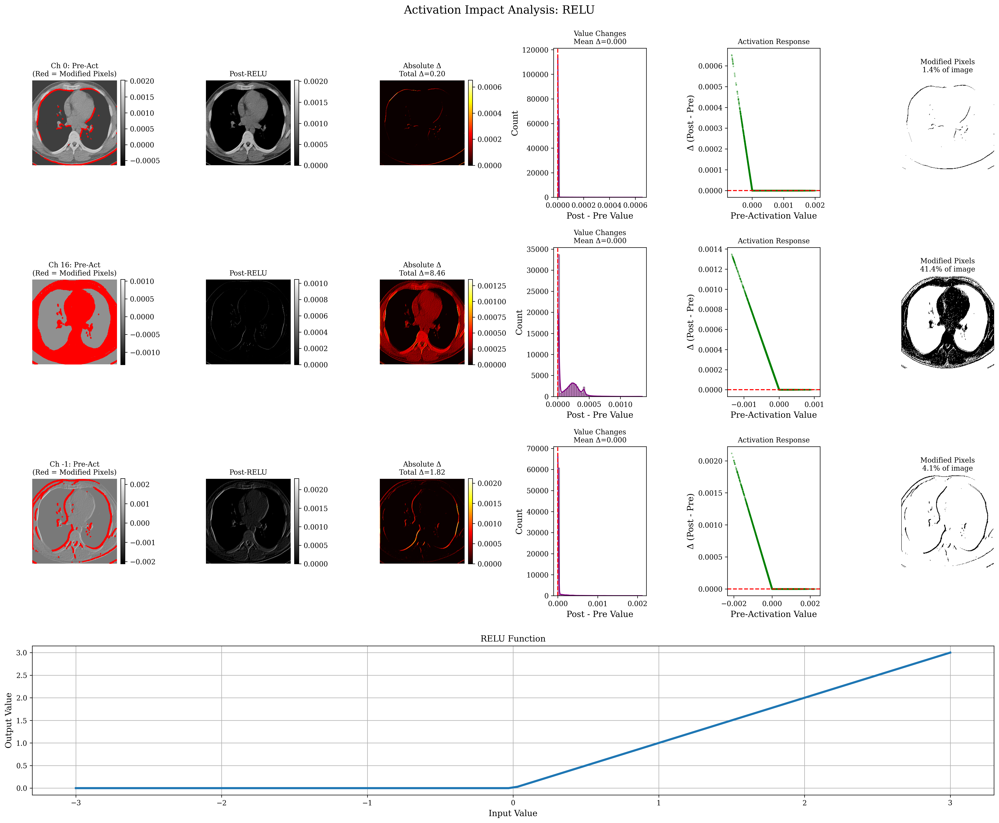


Metrics:
         mean_change: 0.0002
          std_change: 0.0005
       pct_increased: 29.0395
       pct_decreased: 0.0000
    total_abs_change: 330.6746
          max_change: 0.0040


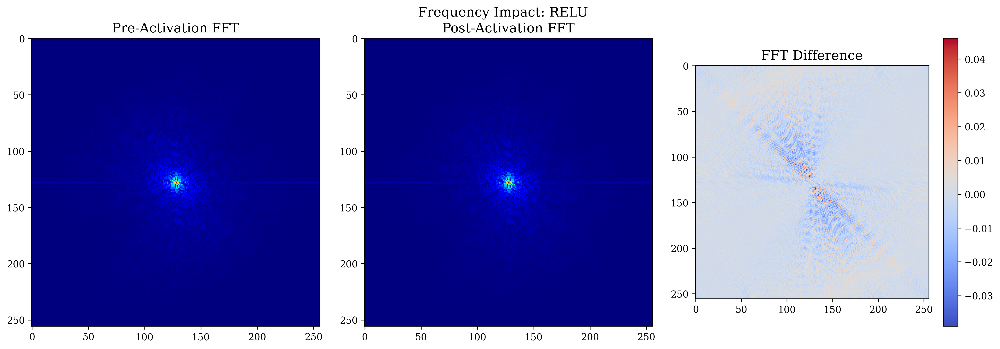


=== LEAKY_RELU ===
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 386ms/step


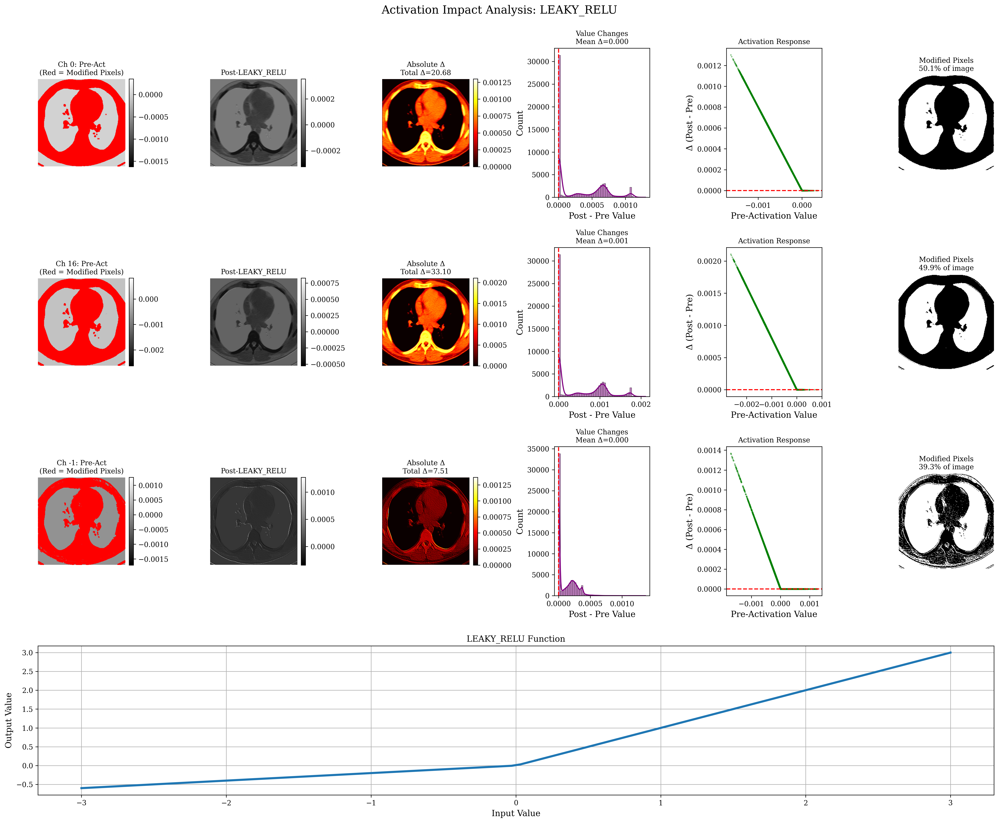


Metrics:
         mean_change: 0.0002
          std_change: 0.0004
       pct_increased: 38.5142
       pct_decreased: 0.0000
    total_abs_change: 440.3985
          max_change: 0.0030


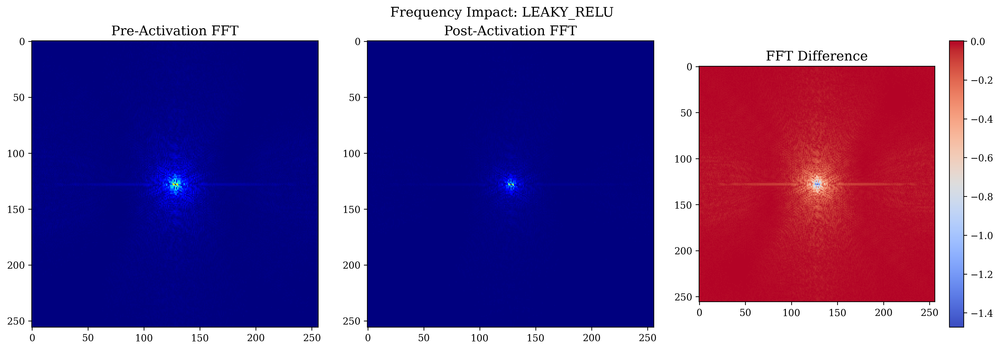


=== SWISH ===
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step


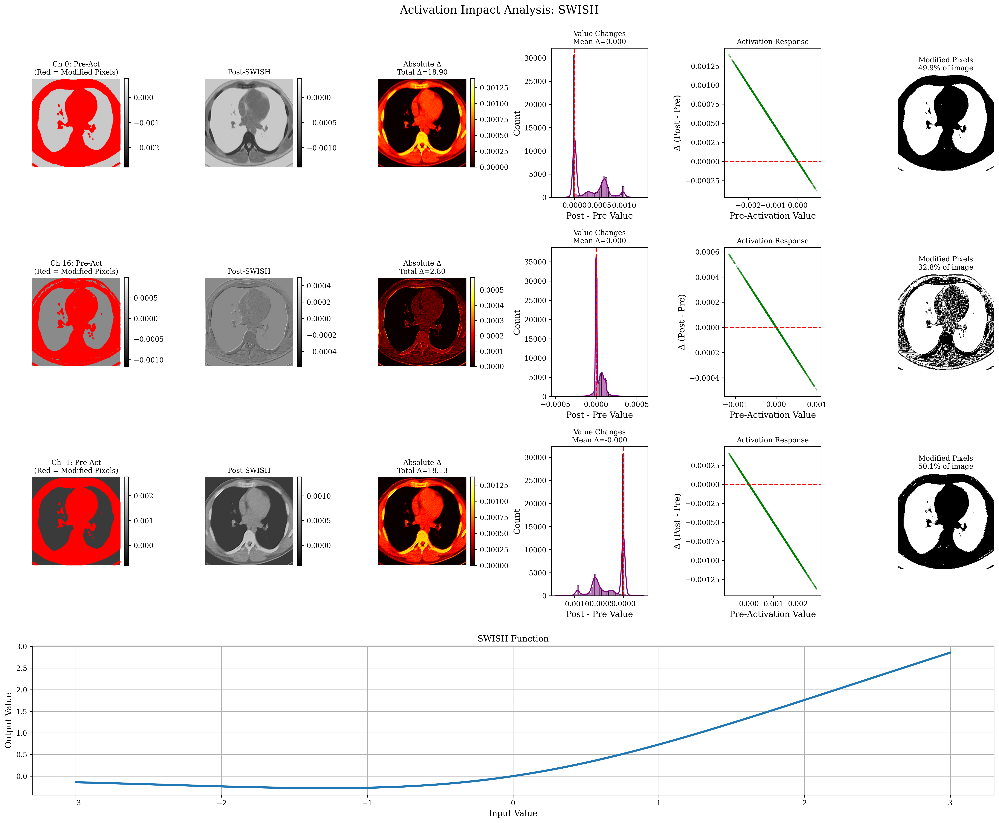


Metrics:
         mean_change: -0.0000
          std_change: 0.0003
       pct_increased: 32.1584
       pct_decreased: 29.8030
    total_abs_change: 375.3946
          max_change: 0.0019


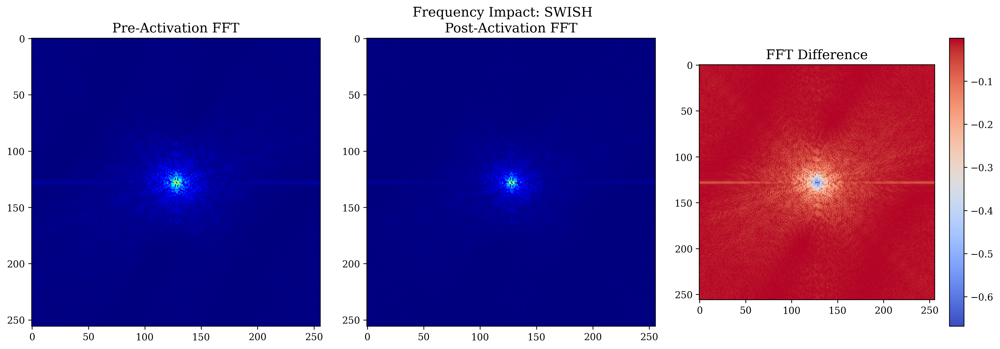


=== GELU ===
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 419ms/step


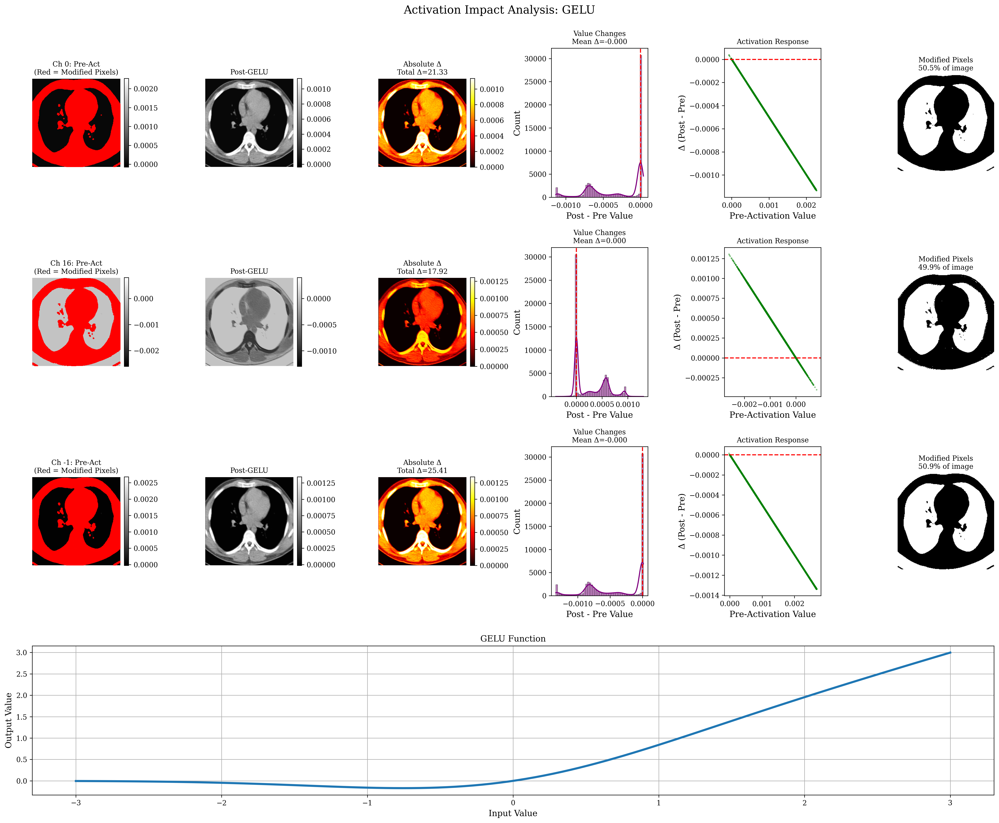


Metrics:
         mean_change: -0.0000
          std_change: 0.0003
       pct_increased: 28.4497
       pct_decreased: 33.5117
    total_abs_change: 429.4021
          max_change: 0.0017


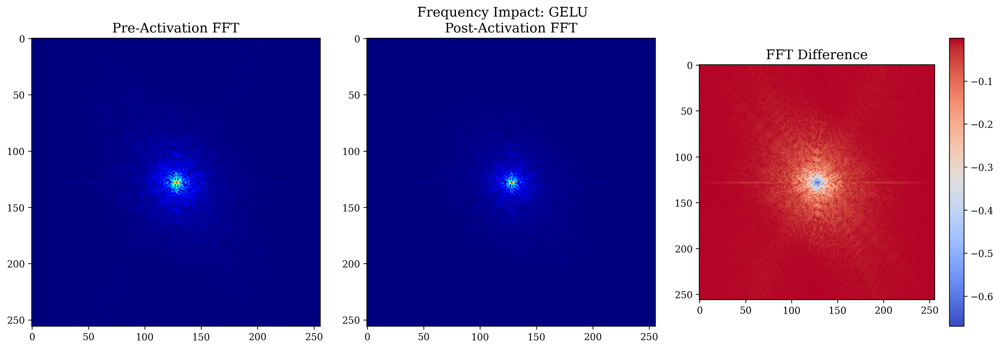

In [ ]:
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.layers import Conv2D, Input, Activation
from tensorflow.keras.models import Model

# ==============================================
# 1. Enhanced Activation Impact Visualization
# ==============================================
def plot_activation_impact_locations(preact, postact, title=""):
    """Visualizes WHERE activations modify values with statistical insights"""
    plt.figure(figsize=(20, 16))

    # Select representative channels
    channels = [0, preact.shape[-1]//2, -1]  # First, middle, last channel

    for i, ch in enumerate(channels):
        pre_ch = preact[0, :, :, ch]
        post_ch = postact[0, :, :, ch]
        diff = post_ch - pre_ch
        abs_diff = np.abs(diff)

        # -------------------------------------
        # Spatial Modifications (Column 1-3)
        # -------------------------------------
        # 1. Pre-Activation with Modification Points
        plt.subplot(4, 6, i*6 + 1)
        plt.imshow(pre_ch, cmap='gray')
        plt.colorbar(fraction=0.046, pad=0.04)
        # Highlight pixels where activation changed values significantly
        threshold = 0.1 * np.max(abs_diff)  # 10% of max change
        modified_mask = abs_diff > threshold
        y, x = np.where(modified_mask)
        plt.scatter(x, y, color='red', s=1, alpha=0.7)
        plt.title(f"Ch {ch}: Pre-Act\n(Red = Modified Pixels)", fontsize=10)
        plt.axis('off')

        # 2. Post-Activation with Modification Intensity
        plt.subplot(4, 6, i*6 + 2)
        plt.imshow(post_ch, cmap='gray')
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.title(f"Post-{title}", fontsize=10)
        plt.axis('off')

        # 3. Modification Heatmap
        plt.subplot(4, 6, i*6 + 3)
        plt.imshow(abs_diff, cmap='hot')
        plt.colorbar(fraction=0.046, pad=0.04)
        plt.title(f"Absolute Δ\nTotal Δ={np.sum(abs_diff):.2f}", fontsize=10)
        plt.axis('off')

        # -------------------------------------
        # Statistical Analysis (Column 4-6)
        # -------------------------------------
        # 4. Value Change Histogram
        plt.subplot(4, 6, i*6 + 4)
        sns.histplot(diff.flatten(), bins=50, kde=True, color='purple')
        plt.axvline(0, color='red', linestyle='--')
        plt.title(f"Value Changes\nMean Δ={diff.mean():.3f}", fontsize=10)
        plt.xlabel('Post - Pre Value')

        # 5. Modification Scatter Plot
        plt.subplot(4, 6, i*6 + 5)
        plt.scatter(pre_ch.flatten(), diff.flatten(),
                   alpha=0.3, c='green', s=2)
        plt.axhline(0, color='red', linestyle='--')
        plt.xlabel('Pre-Activation Value')
        plt.ylabel('Δ (Post - Pre)')
        plt.title(f"Activation Response", fontsize=10)

        # 6. Binary Modification Map
        plt.subplot(4, 6, i*6 + 6)
        plt.imshow(modified_mask, cmap='binary')
        plt.title(f"Modified Pixels\n{modified_mask.mean():.1%} of image", fontsize=10)
        plt.axis('off')

    # -------------------------------------
    # Activation Function Plot (Bottom Row)
    # -------------------------------------
    x = np.linspace(-3, 3, 100)
    activations = {
        'relu': np.maximum(0, x),
        'leaky_relu': np.where(x > 0, x, 0.2*x),
        'swish': x/(1+np.exp(-x)),
        'gelu': 0.5 * x * (1 + np.tanh(np.sqrt(2/np.pi) * (x + 0.044715 * x**3)))
    }

    plt.subplot(4, 1, 4)
    plt.plot(x, activations.get(title.lower(), x), linewidth=3)
    plt.title(f"{title} Function", fontsize=12)
    plt.xlabel('Input Value')
    plt.ylabel('Output Value')
    plt.grid(True)

    plt.tight_layout()
    plt.suptitle(f"Activation Impact Analysis: {title}", y=1.02, fontsize=16)
    plt.show()

# ==============================================
# 2. Quantitative Metrics for Activation Impact
# ==============================================
def activation_impact_metrics(preact, postact):
    """Computes quantitative metrics for activation changes"""
    diff = postact - preact
    abs_diff = np.abs(diff)

    metrics = {
        'mean_change': np.mean(diff),
        'std_change': np.std(diff),
        'pct_increased': np.mean(diff > 0) * 100,
        'pct_decreased': np.mean(diff < 0) * 100,
        'total_abs_change': np.sum(abs_diff),
        'max_change': np.max(abs_diff)
    }
    return metrics

# ==============================================
# 3. Frequency Domain Analysis (FFT)
# ==============================================
def plot_frequency_impact(preact, postact, title=""):
    """Analyzes frequency-domain impact of activation"""
    pre_fft = np.fft.fft2(preact[0, :, :, 0])
    post_fft = np.fft.fft2(postact[0, :, :, 0])

    pre_mag = np.log(1 + np.abs(np.fft.fftshift(pre_fft)))
    post_mag = np.log(1 + np.abs(np.fft.fftshift(post_fft)))

    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(pre_mag, cmap='jet')
    plt.title("Pre-Activation FFT")

    plt.subplot(1, 3, 2)
    plt.imshow(post_mag, cmap='jet')
    plt.title("Post-Activation FFT")

    plt.subplot(1, 3, 3)
    plt.imshow(post_mag - pre_mag, cmap='coolwarm')
    plt.title("FFT Difference")
    plt.colorbar()
    plt.suptitle(f"Frequency Impact: {title}", fontsize=14)
    plt.show()

# ==============================================
# 4. Task-Specific Execution (Deblurring/SR/Deblocking)
# ==============================================
def load_image(path):
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.convert_image_dtype(img, tf.float32)
    while len(img.shape) > 3:
        img = tf.squeeze(img, axis=0)
    return img

# 2. Preprocess (resize and batch)
def preprocess(img, target_size=(256, 256)):
    img = tf.image.resize(img, target_size)
    return tf.expand_dims(img, axis=0)

def build_model(activation='relu'):
    inp = Input(shape=(256, 256, 3))
    x = Conv2D(32, 3, padding='same')(inp)
    x_act = Activation(activation)(x)
    x_out = Conv2D(3, 3, padding='same')(x_act)
    return Model(inp, [x, x_act, x_out])

# Load test image
img = load_image('CT.png')
img = preprocess(img)
img = img / 255.0

# Test all activations
activations = ['relu', 'leaky_relu', 'swish', 'gelu']

for act in activations:
    print(f"\n\033[1m=== {act.upper()} ===\033[0m")
    model = build_model(activation=act)
    preact, postact, _ = model.predict(img)

    # Spatial impact
    plot_activation_impact_locations(preact, postact, title=act.upper())

    # Quantitative metrics
    metrics = activation_impact_metrics(preact, postact)
    print("\nMetrics:")
    for k, v in metrics.items():
        print(f"{k:>20}: {v:.4f}")

    # Frequency impact
    plot_frequency_impact(preact, postact, title=act.upper())

## Task specific comparison

## A widget for comparison (Tested only in colab)

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.layers import (
    Conv2D, Input, Activation, Add, UpSampling2D, Concatenate, LeakyReLU
)
from tensorflow.keras.models import Model
from skimage.transform import resize
from skimage.util import random_noise
import cv2
from io import BytesIO
from PIL import Image
import ipywidgets as widgets
from IPython.display import display, clear_output

# ==============================================
# 0. Image Degradation Functions
# ==============================================
def create_blurry_image(img, kernel_size=15):
    """Apply Gaussian blur to create blurry image"""
    img = img.astype(np.float32)
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def create_blocked_image(img, quality=10):
    """Simulate JPEG blocking artifacts"""
    _, encoded_img = cv2.imencode('.jpg', (img * 255).astype(np.uint8), [int(cv2.IMWRITE_JPEG_QUALITY), quality])
    blocked_img = cv2.imdecode(encoded_img, 1).astype(np.float32) / 255.0
    return blocked_img

def create_downsampled_image(img, scale_factor=0.25):
    """Create low-resolution version by downsampling"""
    h, w = img.shape[:2]
    lr_img = resize(img, (int(h * scale_factor), int(w * scale_factor)), anti_aliasing=True)
    # Upsample back to original size for comparison
    return resize(lr_img, (h, w), order=0).astype(np.float32)  # Nearest neighbor for pixelated look

# ==============================================
# Step 1. Task-specific model architectures
# ==============================================
def build_deblur_model(activation='relu'):
    """U-Net for deblurring with skip connections"""
    inputs = Input(shape=(None, None, 3))
    # Encoder
    x1 = Conv2D(32, 3, padding='same')(inputs)
    x1 = Activation(activation)(x1)
    x2 = Conv2D(64, 3, strides=2, padding='same')(x1)
    x2 = Activation(activation)(x2)
    # Bottleneck
    x3 = Conv2D(128, 3, padding='same')(x2)
    x3 = Activation(activation)(x3)
    # Decoder
    x4 = Conv2D(64, 3, padding='same')(x3)
    x4 = Activation(activation)(x4)
    x4 = UpSampling2D(2)(x4)
    x4 = Concatenate()([x4, x1])  # Skip connection
    outputs = Conv2D(3, 3, padding='same', activation='sigmoid')(x4)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

def build_sr_model(activation='relu'):
    """EDSR-like model for super-resolution"""
    inputs = Input(shape=(None, None, 3))
    x = Conv2D(64, 3, padding='same')(inputs)
    # Residual blocks
    for _ in range(4):
        x_res = Conv2D(64, 3, padding='same')(x)
        x_res = Activation(activation)(x_res)
        x_res = Conv2D(64, 3, padding='same')(x_res)
        x = Add()([x, x_res])
    # Upsampling
    x = UpSampling2D(2)(x)
    outputs = Conv2D(3, 3, padding='same', activation='sigmoid')(x)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

def build_deblock_model(activation='relu'):
    """DnCNN-like model for deblocking"""
    inputs = Input(shape=(None, None, 3))
    x = Conv2D(64, 3, padding='same')(inputs)
    x = Activation(activation)(x)
    for _ in range(5):
        x = Conv2D(64, 3, padding='same')(x)
        x = Activation(activation)(x)
    outputs = Conv2D(3, 3, padding='same', activation='sigmoid')(x)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

# ==============================================
# Step 2. Image upload and processing
# ==============================================
def upload_image():
    """Create widget for image upload"""
    upload = widgets.FileUpload(
        accept='image/*',
        multiple=False,
        description='Upload Image'
    )
    display(upload)
    def on_upload_change(change):
        if not upload.value:
            return
        # Get uploaded image
        uploaded = next(iter(upload.value.values()))
        img = Image.open(BytesIO(uploaded['content']))
        img = np.array(img, dtype=np.float32) / 255.0  # Convert to float32
        # Ensure 3 channels (convert grayscale to RGB)
        if len(img.shape) == 2:
            img = np.stack([img] * 3, axis=-1)
        elif img.shape[2] == 4:
            img = img[:, :, :3]
        # Store original image
        global original_img, degraded_images
        original_img = img
        # Create degraded versions
        degraded_images = {
            'blurry': create_blurry_image(img),
            'blocked': create_blocked_image(img),
            'downsampled': create_downsampled_image(img)
        }
        # Display images
        clear_output()
        display(upload)
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 4, 1)
        plt.imshow(original_img)
        plt.title('Original Image')
        plt.subplot(1, 4, 2)
        plt.imshow(degraded_images['blurry'])
        plt.title('Blurry Image')
        plt.subplot(1, 4, 3)
        plt.imshow(degraded_images['blocked'])
        plt.title('Blocked Image')
        plt.subplot(1, 4, 4)
        plt.imshow(degraded_images['downsampled'])
        plt.title('Downsampled Image')
        plt.tight_layout()
        plt.show()
        # Show analysis buttons
        display(analysis_buttons)
    upload.observe(on_upload_change, names='value')
    return upload

# ==============================================
# Step 3. Analysis function definitions
# ==============================================
def analyze_activation_impact(model, degraded_img, original_img, task='deblurring'):
    """Runs full analysis pipeline for a given task"""
    # Prepare images
    degraded_img = np.expand_dims(degraded_img.astype(np.float32), 0)
    original_img = np.expand_dims(original_img.astype(np.float32), 0)

    # Get restored image
    restored_img = model.predict(degraded_img)[0].astype(np.float32)

    # Ensure restored_img and original_img have the same shape
    if restored_img.shape != original_img[0].shape:
        restored_img = resize(restored_img, original_img[0].shape[:2], anti_aliasing=True)

    # Find the last layer with an activation function
    last_activation_layer = None
    for layer in reversed(model.layers):
        if hasattr(layer, 'activation'):
            last_activation_layer = layer
            break

    # Get intermediate activations if we found an activation layer
    if last_activation_layer:
        partial_model = Model(model.input, last_activation_layer.output)
        preact = partial_model.predict(degraded_img)[0].astype(np.float32)
        postact = restored_img.astype(np.float32)
        activation_name = last_activation_layer.activation.__name__
    else:
        preact = postact = None
        activation_name = "No activation layer found"

    # Plot results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(degraded_img[0])
    plt.title('Degraded Image')
    plt.subplot(1, 3, 2)
    plt.imshow(restored_img)
    plt.title('Restored Image')
    plt.subplot(1, 3, 3)
    plt.imshow(original_img[0])
    plt.title('Original Image')
    plt.suptitle(f"{task.upper()} - {activation_name}")
    plt.tight_layout()
    plt.show()

    # Task-specific metrics
    metrics = {
        'psnr': tf.image.psnr(
            tf.convert_to_tensor(restored_img[np.newaxis], dtype=tf.float32),
            tf.convert_to_tensor(original_img, dtype=tf.float32),
            max_val=1.0
        ).numpy()[0],
        'ssim': tf.image.ssim(
            tf.convert_to_tensor(restored_img[np.newaxis], dtype=tf.float32),
            tf.convert_to_tensor(original_img, dtype=tf.float32),
            max_val=1.0
        ).numpy()[0],
        'mse': np.mean((restored_img - original_img[0]) ** 2)
    }

    if task == 'deblurring':
        metrics['edge_preservation'] = np.mean([
            np.abs(np.gradient(restored_img[..., c] - degraded_img[0][..., c])).mean()
            for c in range(3)
        ])
    elif task == 'super_resolution':
        metrics['sharpness'] = np.mean([
            np.abs(np.gradient(restored_img[..., c])).mean()
            for c in range(3)
        ])
    elif task == 'deblocking':
        metrics['blocking_artifacts'] = np.std(restored_img[::8, ::8, :])

    return metrics

def evaluate_activations_for_task(task='deblurring'):
    """Full comparative evaluation for a specific task"""
    # Get appropriate degraded image
    if task == 'deblurring':
        degraded_img = degraded_images['blurry']
        build_model = build_deblur_model
    elif task == 'super_resolution':
        degraded_img = degraded_images['downsampled']
        build_model = build_sr_model
    elif task == 'deblocking':
        degraded_img = degraded_images['blocked']
        build_model = build_deblock_model
    # Test all activation functions
    results = {}
    activations = ['relu', 'leaky_relu', 'swish', 'gelu']
    for act in activations:
        print(f"\nEvaluating {act.upper()} for {task}...")
        model = build_model(activation=act)
        metrics = analyze_activation_impact(model, degraded_img, original_img, task=task)
        results[act] = metrics
        print(f"\n{act.upper()} Results:")
        for k, v in metrics.items():
            print(f"{k:>20}: {v:.4f}")
    # Comparative visualization
    plot_task_comparison(results, task=task)
    return results

def plot_task_comparison(results, task):
    """Comparative bar plots for task-specific metrics"""
    metrics = list(results['relu'].keys())
    n_metrics = len(metrics)
    plt.figure(figsize=(15, 5))
    for i, metric in enumerate(metrics):
        plt.subplot(1, n_metrics, i+1)
        values = [results[act][metric] for act in results]
        plt.bar(results.keys(), values)
        plt.title(metric)
        plt.ylabel('Score')
    plt.suptitle(f"Activation Function Comparison: {task.upper()}", y=1.05)
    plt.tight_layout()
    plt.show()

# ==============================================
# Step 4. Definition of interactive interface for widget
# ==============================================
# Create analysis buttons
analysis_buttons = widgets.ToggleButtons(
    options=['Deblurring', 'Super-Resolution', 'Deblocking', 'All Tasks'],
    description='Task:',
    disabled=False,
    button_style=''
)
def on_button_click(change):
    if change['new'] == 'Deblurring':
        evaluate_activations_for_task('deblurring')
    elif change['new'] == 'Super-Resolution':
        evaluate_activations_for_task('super_resolution')
    elif change['new'] == 'Deblocking':
        evaluate_activations_for_task('deblocking')
    elif change['new'] == 'All Tasks':
        evaluate_activations_for_task('deblurring')
        evaluate_activations_for_task('super_resolution')
        evaluate_activations_for_task('deblocking')
analysis_buttons.observe(on_button_click, names='value')

# ==============================================
# Step 5. Main function call
# ==============================================
print("Please upload an image to begin analysis:")
upload = upload_image()

## Code to improve restoration quality

In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.layers import (
    Conv2D, Input, Activation, Add, UpSampling2D, Concatenate, LeakyReLU, LayerNormalization
)
from tensorflow.keras.models import Model
from skimage.transform import resize
from skimage.util import random_noise
import cv2
from io import BytesIO
from PIL import Image
import ipywidgets as widgets
from IPython.display import display, clear_output

# ==============================================
# 0. Image Degradation Functions
# ==============================================
def generate_synthetic_dataset(original_img, degradation_func, num_samples=100, **kwargs):
    """
    Generate a synthetic dataset by applying a degradation function to the original image.

    Parameters:
        original_img (np.ndarray): The original high-quality image.
        degradation_func (function): Function to degrade the image (e.g., create_blurry_image).
        num_samples (int): Number of degraded images to generate.
        **kwargs: Additional arguments to pass to the degradation function.

    Returns:
        degraded_images (np.ndarray): Array of degraded images.
        ground_truth_images (np.ndarray): Array of corresponding ground truth images.
    """
    degraded_images = []
    ground_truth_images = []
    for _ in range(num_samples):
        # Apply random transformations to the original image
        img = random_transform(original_img)
        degraded_img = degradation_func(img, **kwargs)
        degraded_images.append(degraded_img)
        ground_truth_images.append(img)
    return np.array(degraded_images), np.array(ground_truth_images)
def create_blurry_image(img, kernel_size=25):
    """Apply Gaussian blur to create blurry image"""
    img = img.astype(np.float32)
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def create_blocked_image(img, quality=5):
    """Simulate JPEG blocking artifacts"""
    _, encoded_img = cv2.imencode('.jpg', (img * 255).astype(np.uint8), [int(cv2.IMWRITE_JPEG_QUALITY), quality])
    blocked_img = cv2.imdecode(encoded_img, 1).astype(np.float32) / 255.0
    return blocked_img

def create_downsampled_image(img, scale_factor=0.50):
    """Create low-resolution version by downsampling"""
    h, w = img.shape[:2]
    lr_img = resize(img, (int(h * scale_factor), int(w * scale_factor)), anti_aliasing=True)
    # Upsample back to original size for comparison
    return resize(lr_img, (h, w), order=0).astype(np.float32)  # Nearest neighbor for pixelated look

# ==============================================
# 1. Task-Specific Model Architectures
# ==============================================
def build_deblur_model(activation='relu'):
    """Enhanced U-Net for deblurring with skip connections and attention"""
    inputs = Input(shape=(None, None, 3))
    # Encoder
    x1 = Conv2D(64, 3, padding='same')(inputs)
    x1 = Activation(activation)(x1)
    x2 = Conv2D(128, 3, strides=2, padding='same')(x1)
    x2 = Activation(activation)(x2)
    # Bottleneck with attention
    x3 = Conv2D(256, 3, padding='same')(x2)
    x3 = Activation(activation)(x3)
    x3 = LayerNormalization()(x3)
    # Decoder
    x4 = UpSampling2D(2)(x3)
    x4 = Conv2D(128, 3, padding='same')(x4)
    x4 = Activation(activation)(x4)
    x4 = Concatenate()([x4, x1])  # Skip connection
    outputs = Conv2D(3, 3, padding='same', activation='linear')(x4)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

def build_sr_model(activation='relu'):
    """Enhanced EDSR-like model for super-resolution"""
    inputs = Input(shape=(None, None, 3))
    x = Conv2D(64, 3, padding='same')(inputs)
    # Residual blocks
    for _ in range(16):  # Increased residual blocks
        x_res = Conv2D(64, 3, padding='same')(x)
        x_res = Activation(activation)(x_res)
        x_res = Conv2D(64, 3, padding='same')(x_res)
        x = Add()([x, x_res])
    # Upsampling
    x = UpSampling2D(2)(x)
    x = Conv2D(64, 3, padding='same')(x)
    x = Activation(activation)(x)
    outputs = Conv2D(3, 3, padding='same', activation='linear')(x)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

def build_deblock_model(activation='relu'):
    """Enhanced DnCNN-like model for deblocking"""
    inputs = Input(shape=(None, None, 3))
    x = Conv2D(64, 3, padding='same')(inputs)
    x = Activation(activation)(x)
    for _ in range(16):  # Increased residual blocks
        x = Conv2D(64, 3, padding='same')(x)
        x = Activation(activation)(x)
    outputs = Conv2D(3, 3, padding='same', activation='linear')(x)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mse')
    return model

# ==============================================
# 2. Image Upload and Processing
# ==============================================
def upload_image():
    """Create widget for image upload"""
    upload = widgets.FileUpload(
        accept='image/*',
        multiple=False,
        description='Upload Image'
    )
    display(upload)
    def on_upload_change(change):
        if not upload.value:
            return
        # Get uploaded image
        uploaded = next(iter(upload.value.values()))
        img = Image.open(BytesIO(uploaded['content']))
        img = np.array(img, dtype=np.float32) / 255.0  # Convert to float32
        # Ensure 3 channels (convert grayscale to RGB)
        if len(img.shape) == 2:
            img = np.stack([img] * 3, axis=-1)
        elif img.shape[2] == 4:
            img = img[:, :, :3]
        # Store original image
        global original_img, degraded_images
        original_img = img
        # Create degraded versions
        degraded_images = {
            'blurry': create_blurry_image(img),
            'blocked': create_blocked_image(img),
            'downsampled': create_downsampled_image(img)
        }
        # Display images
        clear_output()
        display(upload)
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 4, 1)
        plt.imshow(original_img)
        plt.title('Original Image')
        plt.subplot(1, 4, 2)
        plt.imshow(degraded_images['blurry'])
        plt.title('Blurry Image')
        plt.subplot(1, 4, 3)
        plt.imshow(degraded_images['blocked'])
        plt.title('Blocked Image')
        plt.subplot(1, 4, 4)
        plt.imshow(degraded_images['downsampled'])
        plt.title('Downsampled Image')
        plt.tight_layout()
        plt.show()
        # Show analysis buttons
        display(analysis_buttons)
    upload.observe(on_upload_change, names='value')
    return upload

# ==============================================
# 3. Analysis Functions
# ==============================================
def analyze_activation_impact(model, degraded_img, original_img, task='deblurring'):
    """Runs full analysis pipeline for a given task"""
    # Prepare images
    degraded_img = np.expand_dims(degraded_img.astype(np.float32), 0)
    original_img = np.expand_dims(original_img.astype(np.float32), 0)

    # Get restored image
    restored_img = model.predict(degraded_img)[0].astype(np.float32)
    restored_img = np.clip(restored_img, 0.0, 1.0)
    # Ensure restored_img and original_img have the same shape
    if restored_img.shape != original_img[0].shape:
        restored_img = resize(restored_img, original_img[0].shape[:2], anti_aliasing=True)

    # Find the last layer with an activation function
    last_activation_layer = None
    for layer in reversed(model.layers):
        if hasattr(layer, 'activation'):
            last_activation_layer = layer
            break

    # Get intermediate activations if we found an activation layer
    if last_activation_layer:
        partial_model = Model(model.input, last_activation_layer.output)
        preact = partial_model.predict(degraded_img)[0].astype(np.float32)
        postact = restored_img.astype(np.float32)
        activation_name = last_activation_layer.activation.__name__
    else:
        preact = postact = None
        activation_name = "No activation layer found"

    # Plot results
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(degraded_img[0])
    plt.title('Degraded Image')
    plt.subplot(1, 3, 2)
    plt.imshow(restored_img)
    plt.title('Restored Image')
    plt.subplot(1, 3, 3)
    plt.imshow(original_img[0])
    plt.title('Original Image')
    plt.suptitle(f"{task.upper()} - {activation_name}")
    plt.tight_layout()
    plt.show()

    # Task-specific metrics
    metrics = {
        'psnr': tf.image.psnr(
            tf.convert_to_tensor(restored_img[np.newaxis], dtype=tf.float32),
            tf.convert_to_tensor(original_img, dtype=tf.float32),
            max_val=1.0
        ).numpy()[0],
        'ssim': tf.image.ssim(
            tf.convert_to_tensor(restored_img[np.newaxis], dtype=tf.float32),
            tf.convert_to_tensor(original_img, dtype=tf.float32),
            max_val=1.0
        ).numpy()[0],
        'mse': np.mean((restored_img - original_img[0]) ** 2)
    }

    if task == 'deblurring':
        metrics['edge_preservation'] = np.mean([
            np.abs(np.gradient(restored_img[..., c] - degraded_img[0][..., c])).mean()
            for c in range(3)
        ])
    elif task == 'super_resolution':
        metrics['sharpness'] = np.mean([
            np.abs(np.gradient(restored_img[..., c])).mean()
            for c in range(3)
        ])
    elif task == 'deblocking':
        metrics['blocking_artifacts'] = np.std(restored_img[::8, ::8, :])

    return metrics

def evaluate_activations_for_task(task='deblurring'):
    """Full comparative evaluation for a specific task"""
    # Get appropriate degraded image
    if task == 'deblurring':
        degraded_img = degraded_images['blurry']
        build_model = build_deblur_model
    elif task == 'super_resolution':
        degraded_img = degraded_images['downsampled']
        build_model = build_sr_model
    elif task == 'deblocking':
        degraded_img = degraded_images['blocked']
        build_model = build_deblock_model

    # Test all activation functions
    results = {}
    activations = ['relu', 'leaky_relu', 'swish', 'gelu']
    for act in activations:
        print(f"\nEvaluating {act.upper()} for {task}...")
        model = build_model(activation=act)
        metrics = analyze_activation_impact(model, degraded_img, original_img, task=task)
        results[act] = metrics
        print(f"\n{act.upper()} Results:")
        for k, v in metrics.items():
            print(f"{k:>20}: {v:.4f}")

    # Comparative visualization
    plot_task_comparison(results, task=task)
    return results

def plot_task_comparison(results, task):
    """Comparative bar plots for task-specific metrics"""
    metrics = list(results['relu'].keys())
    n_metrics = len(metrics)
    plt.figure(figsize=(15, 5))
    for i, metric in enumerate(metrics):
        plt.subplot(1, n_metrics, i+1)
        values = [results[act][metric] for act in results]
        plt.bar(results.keys(), values)
        plt.title(metric)
        plt.ylabel('Score')
    plt.suptitle(f"Activation Function Comparison: {task.upper()}", y=1.05)
    plt.tight_layout()
    plt.show()

# ==============================================
# 4. Interactive Interface
# ==============================================
# Create analysis buttons
analysis_buttons = widgets.ToggleButtons(
    options=['Deblurring', 'Super-Resolution', 'Deblocking', 'All Tasks'],
    description='Task:',
    disabled=False,
    button_style=''
)

def on_button_click(change):
    if change['new'] == 'Deblurring':
        evaluate_activations_for_task('deblurring')
    elif change['new'] == 'Super-Resolution':
        evaluate_activations_for_task('super_resolution')
    elif change['new'] == 'Deblocking':
        evaluate_activations_for_task('deblocking')
    elif change['new'] == 'All Tasks':
        evaluate_activations_for_task('deblurring')
        evaluate_activations_for_task('super_resolution')
        evaluate_activations_for_task('deblocking')

analysis_buttons.observe(on_button_click, names='value')

# ==============================================
# 5. Main Execution
# ==============================================
print("Please upload an image to begin analysis:")
upload = upload_image()